# COCO Dataset

In [1]:
import sys
sys.path.append('../../')

%load_ext autoreload
%autoreload 2

from dl.data.txtdetn import augmentations
from dl.data.txtdetn import datasets, target_transforms, transforms

In [2]:
augmentation = None

transform = transforms.Compose(
    [transforms.ToTensor(),
     #transforms.Normalize(rgb_means=(0.485, 0.456, 0.406), rgb_stds=(0.229, 0.224, 0.225))]
    ]
)
target_transform = target_transforms.Compose(
    [target_transforms.Corners2Centroids(),
     target_transforms.ToQuadrilateral(),
     target_transforms.ToTensor()]
)
train_dataset = datasets.COCO2014Text_Dataset(ignore=target_transforms.Ignore(illegible=False), transform=transform, target_transform=target_transform, augmentation=None)


loading annotations into memory...
0:00:01.014395
creating index...
index created!


In [3]:
from dl.data.utils.boxes import centroids2corners
#from ssd.core.inference import toVisualizeRectangleRGBimg
from dl.data.utils.converter import toVisualizeQuadsRGBimg, toVisualizeRectRGBimg

%matplotlib notebook
import matplotlib.pyplot as plt
import numpy as np
import cv2, torch

# yellow rectangle is minimum bbox, red one is quadrilateral bbox

['', 'wishes', 'bears', 'BEST', 'from', 'the']


<IPython.core.display.Javascript object>


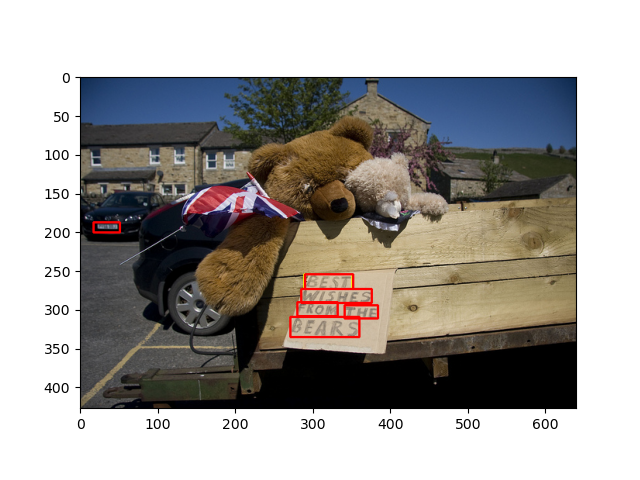

['KT']


<IPython.core.display.Javascript object>


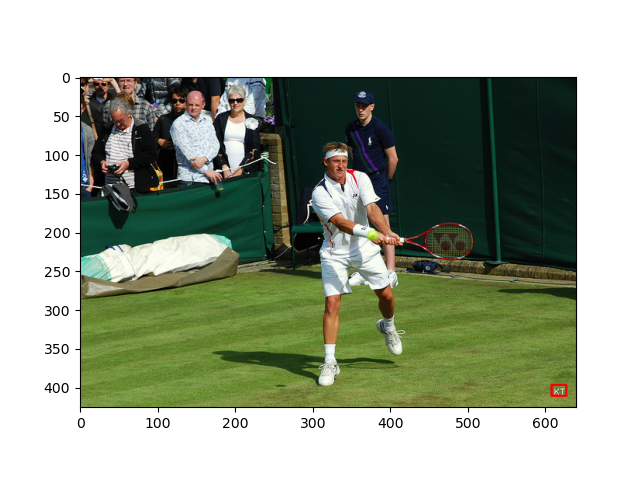

['', '', '', '', 'p', 'airconditioned', 'avs-234', 'd', 'dominion', 'bus', 'lines', '8070', '']


<IPython.core.display.Javascript object>


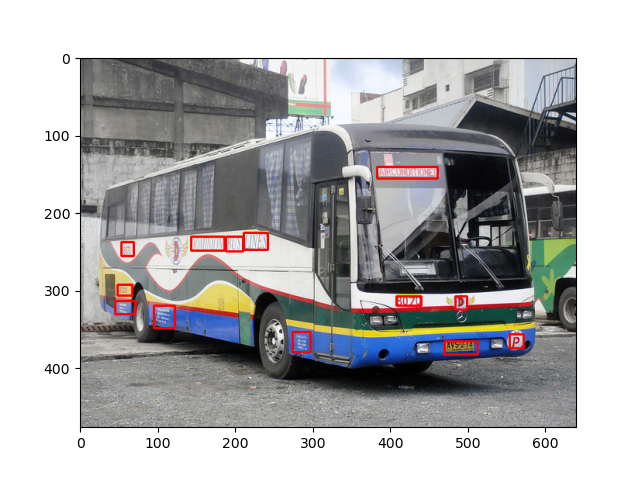

['ats!', '86', '', '', "LET'S", '']


<IPython.core.display.Javascript object>


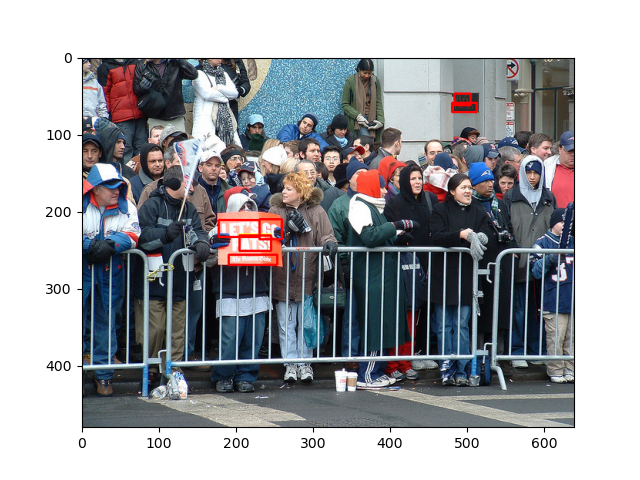

['ave', 'stop', 'BELLONA', 'LOCUST']


<IPython.core.display.Javascript object>


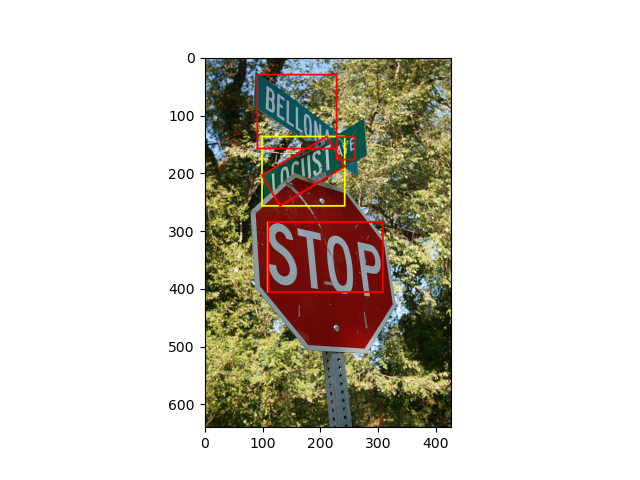

['COLA', 'COCA', '', '', 'COLA', 'COCA', 'XGRAND', '', '', '', '']


<IPython.core.display.Javascript object>


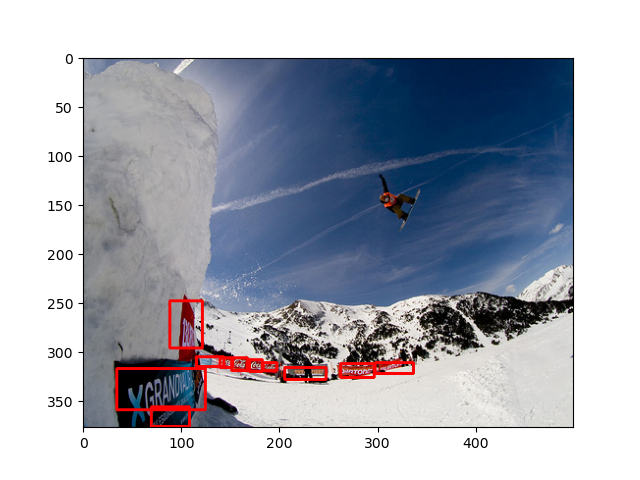

['', '', '', '4']


<IPython.core.display.Javascript object>


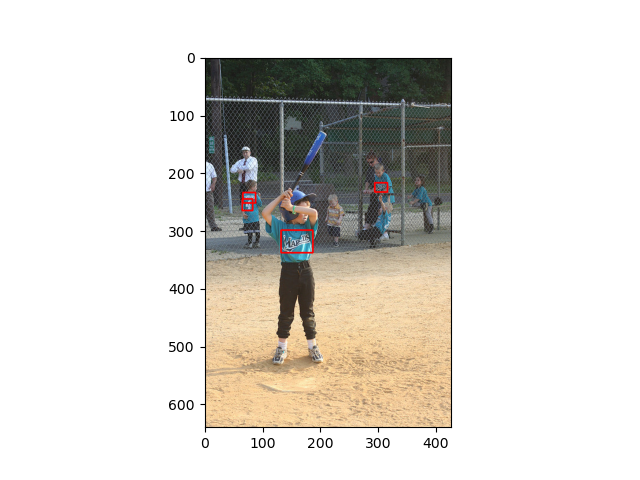

['2013', 'pasay', '71768', '', '', 'smith1866', 'dagupan', '07:25', '05/29/2013', 'leonidas', '', 'aus', 'am']


<IPython.core.display.Javascript object>


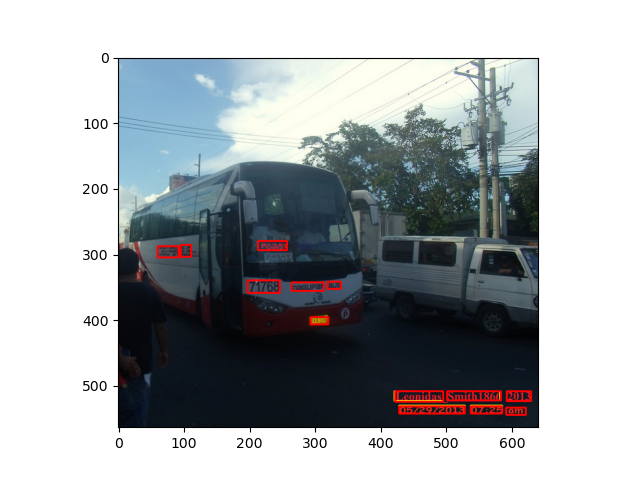

['', '', '201', 'copyright', '2', 'foodnut.c', '2012', 't.com']


<IPython.core.display.Javascript object>


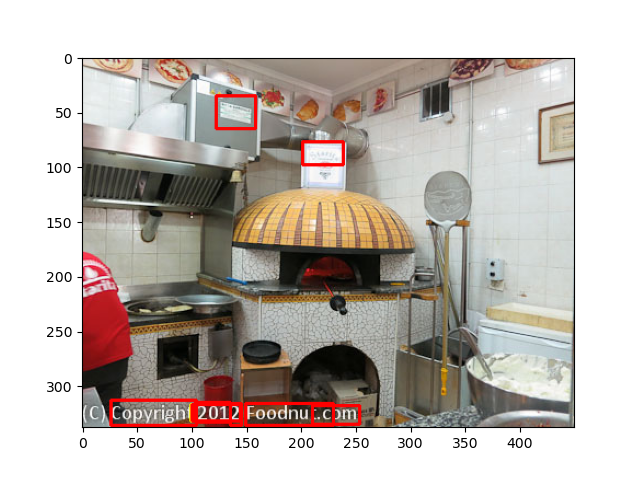

['NO', 'PARKING', '', 'EMERGENCY', '', 'ORDER', 'THORIZED', 'BY', 'TO', 'LODED', 'BE', 'POLICE', 'TO', '', '', '']


<IPython.core.display.Javascript object>


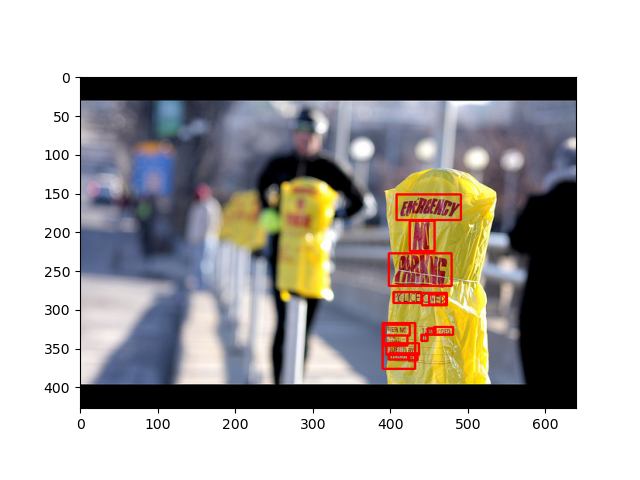

['MOUNT', 'COMPAN', 'RAILW', '1866', 'WASHINGTON', '4', '', '', '', '4', '']


<IPython.core.display.Javascript object>


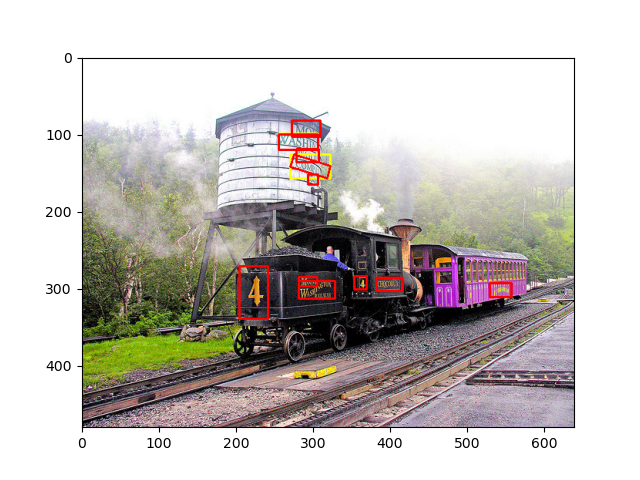

['', '', 'SHOP', 'OR', 'OPEN', '', '', '', '']


<IPython.core.display.Javascript object>


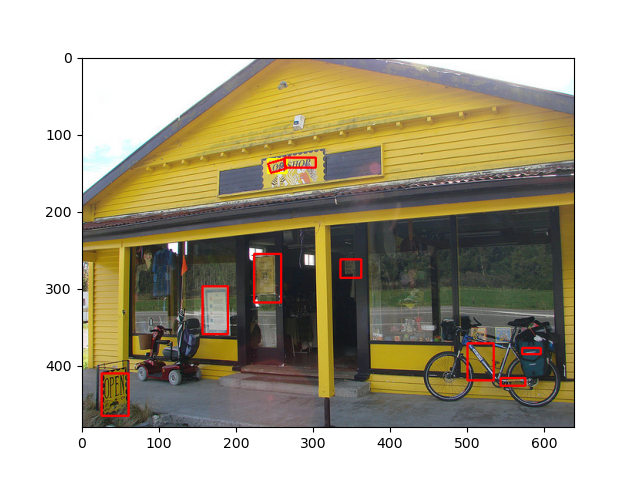

['L.150', '15e', 'li50']


<IPython.core.display.Javascript object>


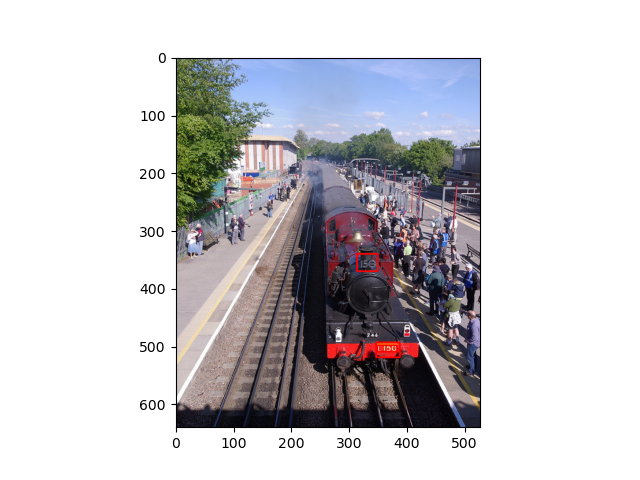

['', 'owo', 'albe', 'Scifi', '']


<IPython.core.display.Javascript object>


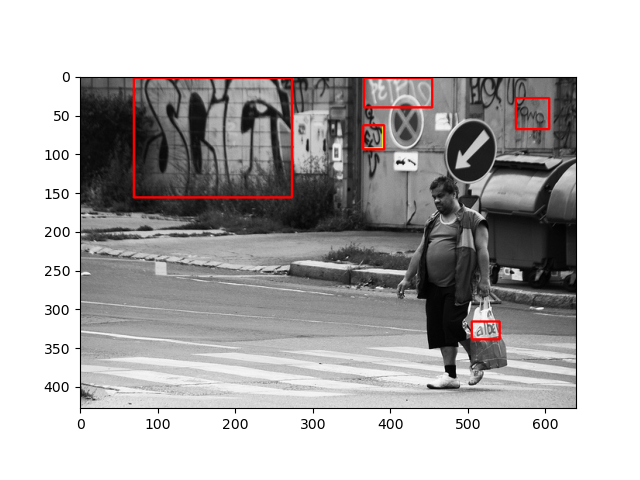

['archives', 'ARCHIVES', 'county', 'ELGIN']


<IPython.core.display.Javascript object>


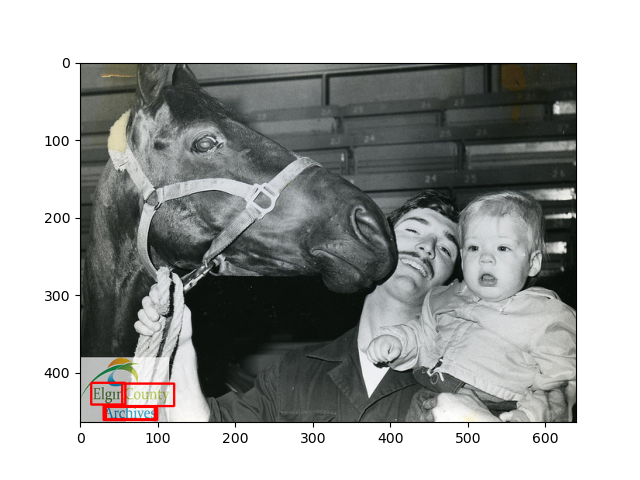

In [4]:
indices = np.random.randint(0, len(train_dataset), 15)

for index in indices:
    img, targets, texts = train_dataset[index]
    
    locs, quads = targets[:, :4], targets[:, 4:12]
    
    print(texts)
    
    img = toVisualizeRectRGBimg(img, locs, rgb=(255,255,0), verbose=False)# yellow
    img = toVisualizeQuadsRGBimg(torch.from_numpy(img.transpose((2, 0, 1)) / 255.), quads, verbose=False)# red

    plt.figure()
    plt.imshow(img)

# SynthText

In [5]:
target_transform = target_transforms.Compose(
    [target_transforms.Corners2Centroids(),
     #target_transforms.ToQuadrilateral(),
     target_transforms.ToTensor()]
)
train_dataset = datasets.SynthTextDetectionDataset(ignore=None, transform=transform, target_transform=target_transform, augmentation=None)

['see', 'and', 'win', 'get', 'good', 'TK>', 'Lines:', 'funny', 'the', '00:42:40']
tensor([[0.5049, 0.1063, 0.1191, 0.0387],
        [0.5849, 0.1342, 0.1253, 0.0614],
        [0.5810, 0.7278, 0.1144, 0.1165],
        [0.3569, 0.5499, 0.1180, 0.1528],
        [0.3273, 0.6296, 0.1917, 0.2271],
        [0.7585, 0.7580, 0.0828, 0.0780],
        [0.3617, 0.1393, 0.2363, 0.0830],
        [0.4699, 0.6068, 0.1290, 0.1616],
        [0.4497, 0.6436, 0.0990, 0.1223],
        [0.6329, 0.8154, 0.2212, 0.1604]])


<IPython.core.display.Javascript object>


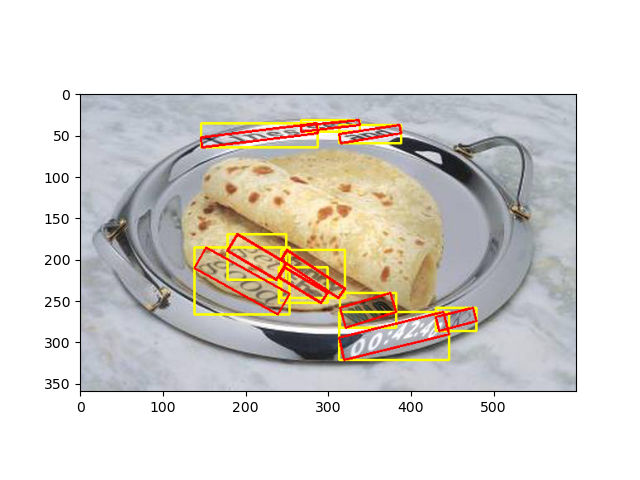

['not', '4Mg', 'height', 'at', 'a', 'Can', 'are', 'if', 'you']
tensor([[0.0696, 0.6190, 0.1388, 0.1939],
        [0.9013, 0.1670, 0.1331, 0.1705],
        [0.7218, 0.2683, 0.1644, 0.1253],
        [0.2273, 0.9535, 0.0470, 0.0748],
        [0.2914, 0.9537, 0.0327, 0.0686],
        [0.0340, 0.2293, 0.0637, 0.0746],
        [0.0625, 0.2847, 0.0486, 0.0546],
        [0.7647, 0.2561, 0.0426, 0.0535],
        [0.8408, 0.3061, 0.0807, 0.0696]])


<IPython.core.display.Javascript object>


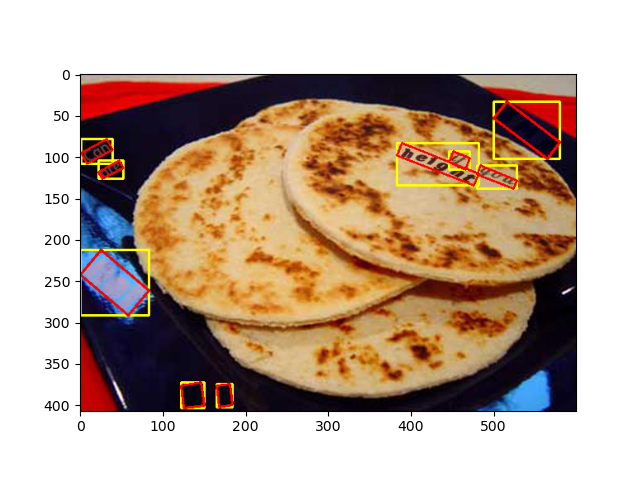

['way', 'Re:', 'was', '>and', 'you']
tensor([[0.1879, 0.0950, 0.1418, 0.0627],
        [0.8176, 0.3303, 0.0554, 0.0548],
        [0.8067, 0.8963, 0.1095, 0.1337],
        [0.5533, 0.7307, 0.1346, 0.1023],
        [0.1568, 0.1163, 0.1188, 0.0530]])


<IPython.core.display.Javascript object>


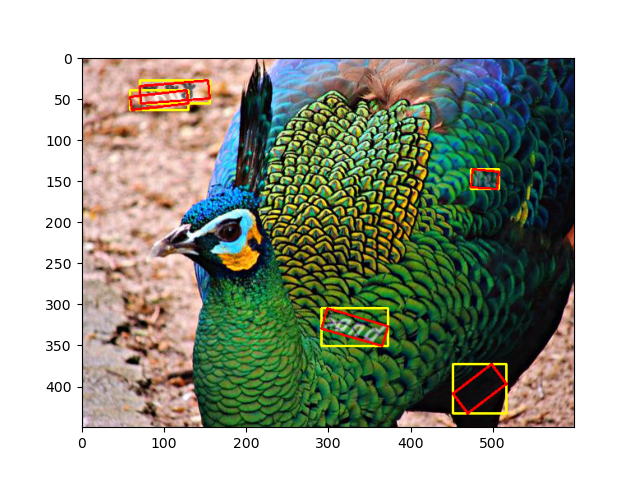

['user', 'set', 'for', 'Date:', 'From:', 'to', 'a', 'died', 'is', 'now']
tensor([[0.7702, 0.4037, 0.1086, 0.0601],
        [0.1523, 0.9661, 0.0645, 0.0734],
        [0.2445, 0.9527, 0.0830, 0.0652],
        [0.7491, 0.7423, 0.1886, 0.2056],
        [0.8338, 0.8852, 0.2171, 0.2220],
        [0.7935, 0.3735, 0.0532, 0.0743],
        [0.8538, 0.3796, 0.0440, 0.0632],
        [0.1521, 0.9022, 0.0891, 0.0874],
        [0.6646, 0.5483, 0.0486, 0.0939],
        [0.7625, 0.5585, 0.1273, 0.0705]])


<IPython.core.display.Javascript object>


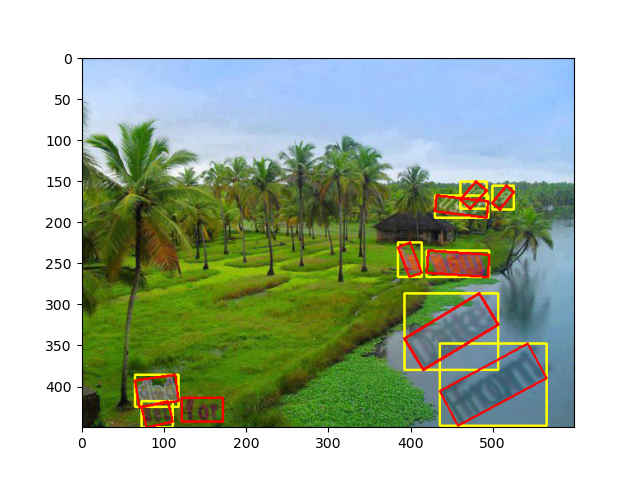

['Netmail:', 'Tue,', 'Message-ID:', 'Don']
tensor([[0.8143, 0.5715, 0.1584, 0.0569],
        [0.8591, 0.3429, 0.0784, 0.0561],
        [0.1124, 0.8715, 0.2198, 0.0588],
        [0.4413, 0.5430, 0.1879, 0.0595]])


<IPython.core.display.Javascript object>


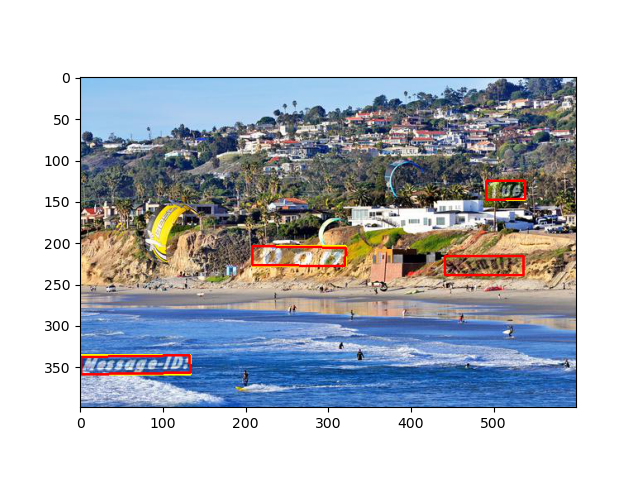

['second', 'and', 'making', 'Andresen', 'will', 'the', 'the', 'Lines:', '9']
tensor([[0.1254, 0.7193, 0.2514, 0.1076],
        [0.5439, 0.5799, 0.1364, 0.1674],
        [0.2772, 0.0855, 0.3422, 0.1822],
        [0.5273, 0.4779, 0.3270, 0.1860],
        [0.3828, 0.4058, 0.0446, 0.0662],
        [0.4107, 0.4519, 0.0448, 0.0663],
        [0.9424, 0.7595, 0.0831, 0.0717],
        [0.3110, 0.1741, 0.1507, 0.0817],
        [0.4422, 0.1966, 0.0447, 0.0843]])


/home/kado/.pyenv/versions/anaconda3-2019.07/envs/dl/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]


<IPython.core.display.Javascript object>


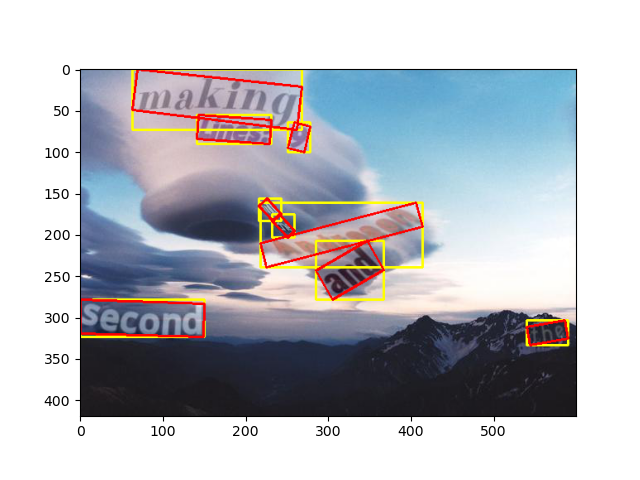

['either', 'idea', 'trade', '>any', 'look']
tensor([[0.0974, 0.0457, 0.0963, 0.0632],
        [0.0644, 0.1151, 0.0753, 0.0665],
        [0.0530, 0.1870, 0.0957, 0.0759],
        [0.5598, 0.2747, 0.1448, 0.0507],
        [0.3579, 0.2769, 0.0954, 0.0394]])


<IPython.core.display.Javascript object>


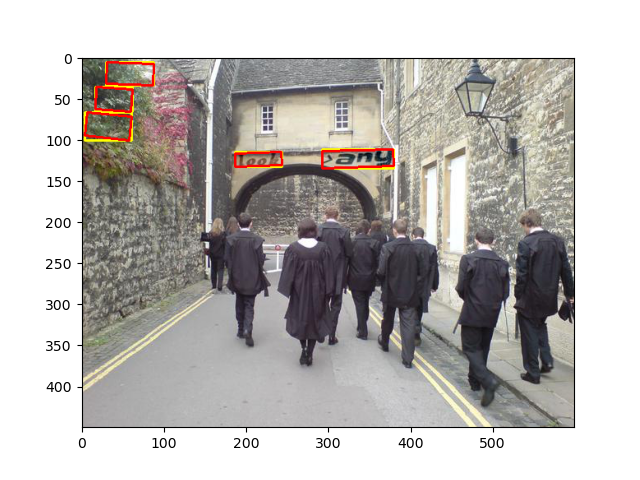

['Cray', 'Date:', 'Care.', 'Re:', 'MRI', '1-2', 'can']
tensor([[0.3139, 0.8202, 0.1839, 0.2662],
        [0.3778, 0.8983, 0.1091, 0.1496],
        [0.8258, 0.1747, 0.2491, 0.1079],
        [0.4842, 0.9297, 0.0806, 0.0753],
        [0.7515, 0.5998, 0.1607, 0.2599],
        [0.9227, 0.7931, 0.0817, 0.1055],
        [0.1256, 0.8886, 0.1261, 0.2187]])


<IPython.core.display.Javascript object>


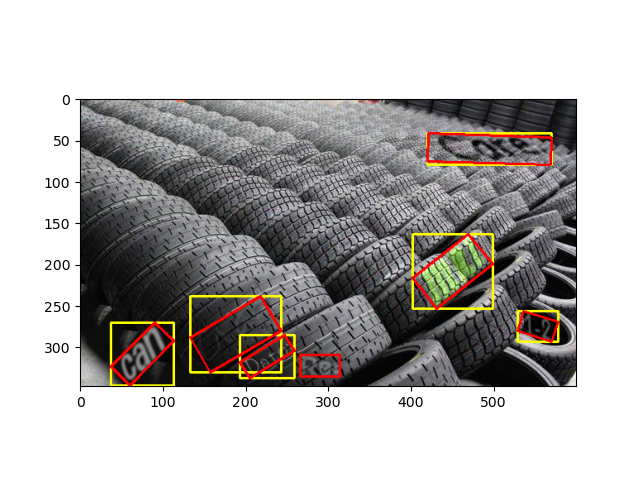

['Sender:', 'amd', 'modem', 'Clinton,', "it's"]
tensor([[0.5673, 0.5578, 0.1552, 0.1385],
        [0.2051, 0.1388, 0.3539, 0.2282],
        [0.5717, 0.6241, 0.1001, 0.1061],
        [0.6268, 0.0896, 0.2528, 0.1465],
        [0.8595, 0.0933, 0.1011, 0.1532]])


<IPython.core.display.Javascript object>


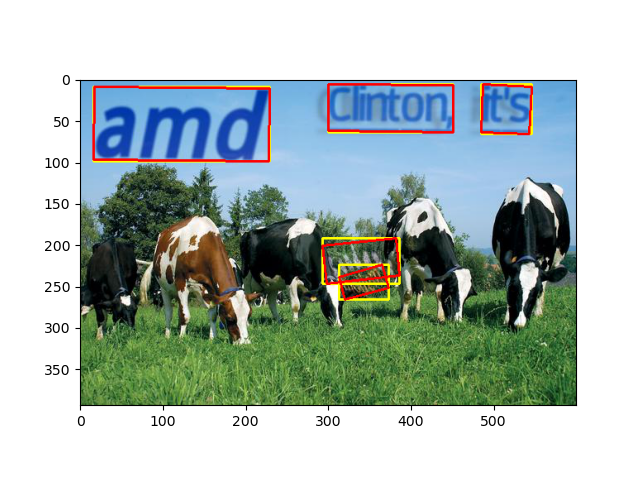

['and', 'Glencoe', 'Ann', 'over', 'of', 'Waterloo', 'both', 'for', 'the', 'the', 'You', 'the']
tensor([[0.9149, 0.8314, 0.1208, 0.0790],
        [0.7909, 0.6723, 0.1046, 0.1122],
        [0.7690, 0.7217, 0.0625, 0.0676],
        [0.5556, 0.7231, 0.1389, 0.0471],
        [0.0942, 0.4155, 0.1164, 0.0625],
        [0.2810, 0.4024, 0.2149, 0.0494],
        [0.6248, 0.2970, 0.1227, 0.1106],
        [0.0790, 0.0515, 0.0859, 0.0468],
        [0.0795, 0.0992, 0.0680, 0.0352],
        [0.0793, 0.1521, 0.0675, 0.0347],
        [0.7922, 0.6336, 0.0766, 0.0871],
        [0.4784, 0.7435, 0.1080, 0.0647]])


<IPython.core.display.Javascript object>


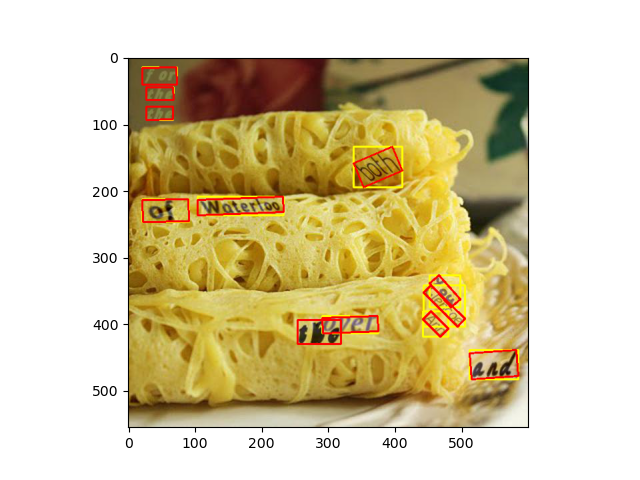

['consider', 'Bone', 'Acting', 'cities', 'of', 'Rob', 'cjpeg', '-Q', 'on,', '19', 'Apr', 'Lines:', 'From:']
tensor([[0.1994, 0.4043, 0.3621, 0.1592],
        [0.4950, 0.9085, 0.1190, 0.0807],
        [0.7936, 0.3810, 0.2965, 0.1392],
        [0.7296, 0.4851, 0.2669, 0.1127],
        [0.9403, 0.5159, 0.0797, 0.1010],
        [0.2830, 0.7443, 0.2254, 0.1391],
        [0.1843, 0.1247, 0.2523, 0.1437],
        [0.4078, 0.1587, 0.0983, 0.1083],
        [0.4208, 0.9581, 0.0932, 0.0714],
        [0.6824, 0.1638, 0.1027, 0.0810],
        [0.8208, 0.2091, 0.1537, 0.1099],
        [0.7666, 0.3050, 0.2544, 0.1160],
        [0.3260, 0.6648, 0.1176, 0.0654]])


<IPython.core.display.Javascript object>


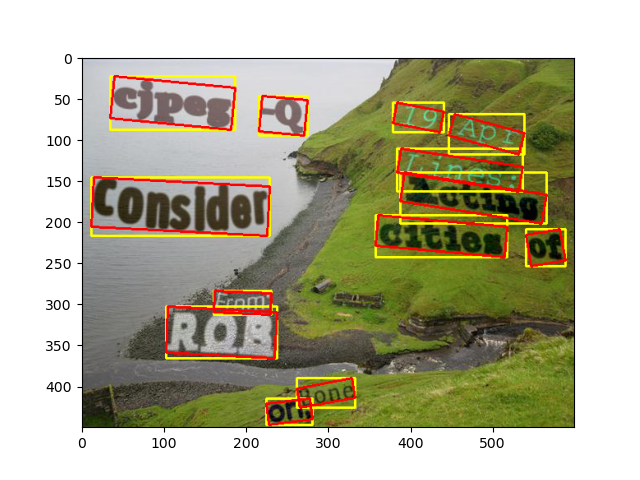

['put', 'him']
tensor([[0.4672, 0.1732, 0.1943, 0.2461],
        [0.6712, 0.1296, 0.1783, 0.1533]])


<IPython.core.display.Javascript object>


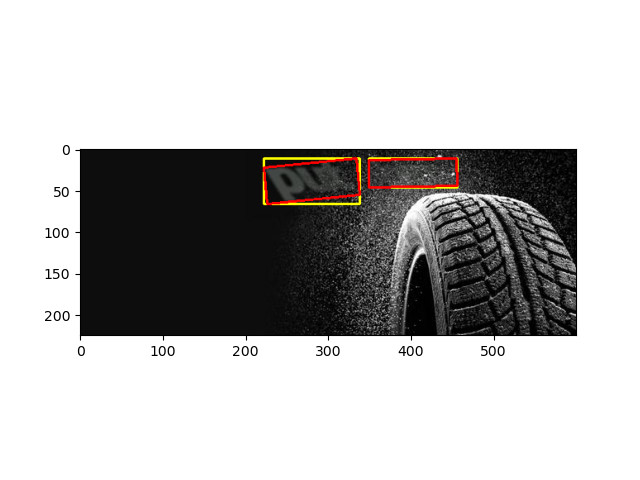

['I', 'can', 'Sender:', 'to', 'HST,', 'then', 'let', 'Xref:', 'Due', 'fees', 'they', 'all', 'users', 'can']
tensor([[0.0220, 0.3266, 0.0480, 0.0834],
        [0.1631, 0.3347, 0.1601, 0.0545],
        [0.7025, 0.4341, 0.1819, 0.1625],
        [0.6878, 0.0694, 0.0434, 0.0578],
        [0.7778, 0.0701, 0.1002, 0.0785],
        [0.8829, 0.0743, 0.0786, 0.0700],
        [0.9669, 0.0698, 0.0523, 0.0537],
        [0.3732, 0.8001, 0.4254, 0.2287],
        [0.7408, 0.3357, 0.0925, 0.0774],
        [0.8047, 0.3496, 0.1104, 0.0983],
        [0.2867, 0.4378, 0.1144, 0.1130],
        [0.1497, 0.5289, 0.1099, 0.0689],
        [0.2875, 0.1787, 0.2426, 0.1019],
        [0.5622, 0.1812, 0.1660, 0.1023]])


<IPython.core.display.Javascript object>


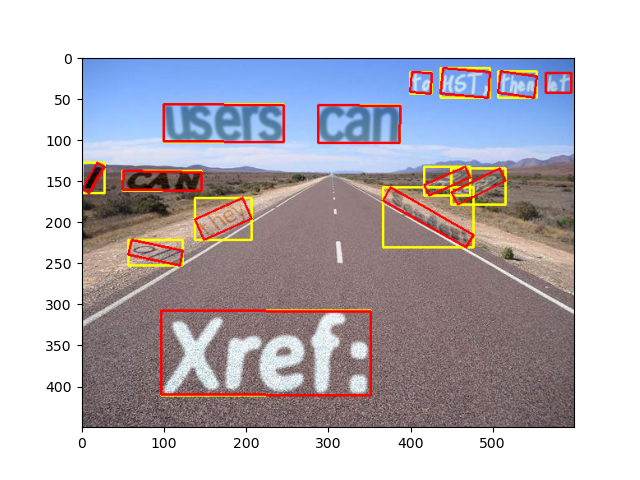

['[not', 'Subject:', 'GMT', 'Xref:', 'From:', 'the', 'anything']
tensor([[0.3445, 0.1420, 0.0837, 0.0548],
        [0.6197, 0.4948, 0.3549, 0.2132],
        [0.7528, 0.5549, 0.2413, 0.1642],
        [0.9104, 0.3415, 0.0750, 0.0352],
        [0.9173, 0.4025, 0.0761, 0.0307],
        [0.3734, 0.1954, 0.0861, 0.0418],
        [0.5154, 0.4531, 0.3250, 0.2121]])


<IPython.core.display.Javascript object>


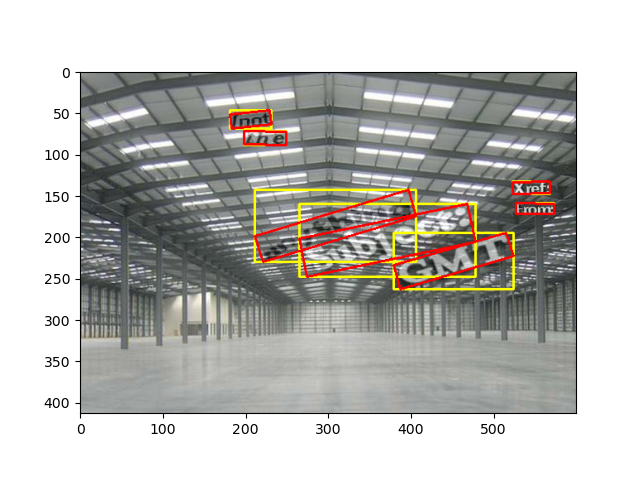

['Re:', 'the', 'Smith', 'time".', 'now', 'and', 'get', 'Gary']
tensor([[0.6924, 0.1767, 0.1997, 0.1005],
        [0.8284, 0.1444, 0.1667, 0.0889],
        [0.1356, 0.8302, 0.1056, 0.1438],
        [0.0540, 0.9158, 0.1188, 0.1675],
        [0.2907, 0.0541, 0.1423, 0.0401],
        [0.1151, 0.0462, 0.1074, 0.0516],
        [0.4287, 0.7889, 0.1212, 0.1317],
        [0.0586, 0.7812, 0.0953, 0.1323]])


<IPython.core.display.Javascript object>


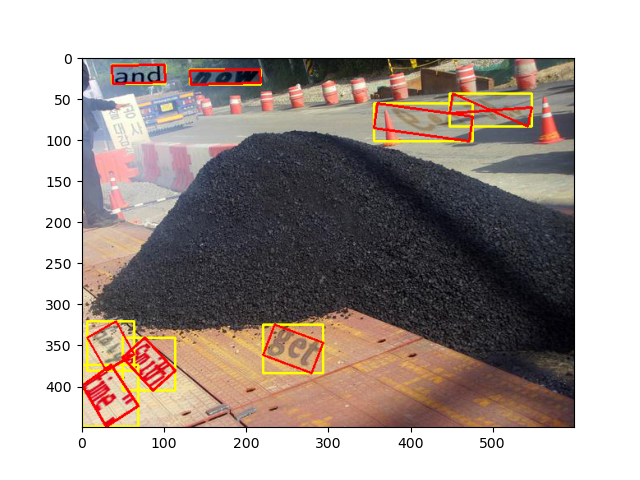

In [6]:
indices = np.random.randint(0, len(train_dataset), 15)

for index in indices:
    img, targets, texts = train_dataset[index]
    
    locs, quads = targets[:, :4], targets[:, 4:12]
    
    print(texts)
    print(locs)
    img = toVisualizeRectRGBimg(img, locs, rgb=(255,255,0), verbose=False)# yellow
    img = toVisualizeQuadsRGBimg(torch.from_numpy(img.transpose((2, 0, 1)) / 255.), quads, verbose=False)# red

    plt.figure()
    plt.imshow(img)

# ICDAR2015

In [7]:
target_transform = target_transforms.Compose(
    [target_transforms.Corners2Centroids(),
     #target_transforms.ToQuadrilateral(),
     target_transforms.ToTensor()]
)
train_dataset = datasets.ICDAR2015TextDataset(ignore=None, transform=transform, target_transform=target_transform, augmentation=None)

['LOVIS', 'DIAMONDS', '###', '15%', '###', 'LOVS', '###', 'SSHA', '###', '###', '###', '###']
tensor([[0.6309, 0.1160, 0.1211, 0.0792],
        [0.6277, 0.1604, 0.0867, 0.0264],
        [0.3926, 0.2424, 0.0195, 0.0181],
        [0.2793, 0.3924, 0.0289, 0.0375],
        [0.7398, 0.3986, 0.0250, 0.0167],
        [0.6523, 0.3167, 0.0344, 0.0194],
        [0.4496, 0.2979, 0.0367, 0.0236],
        [0.0391, 0.1715, 0.0781, 0.0542],
        [0.4004, 0.0222, 0.0367, 0.0444],
        [0.2703, 0.3931, 0.0187, 0.1972],
        [0.9895, 0.4278, 0.0148, 0.0278],
        [0.5137, 0.3903, 0.0211, 0.0167]])


/home/kado/.pyenv/versions/anaconda3-2019.07/envs/dl/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]


<IPython.core.display.Javascript object>


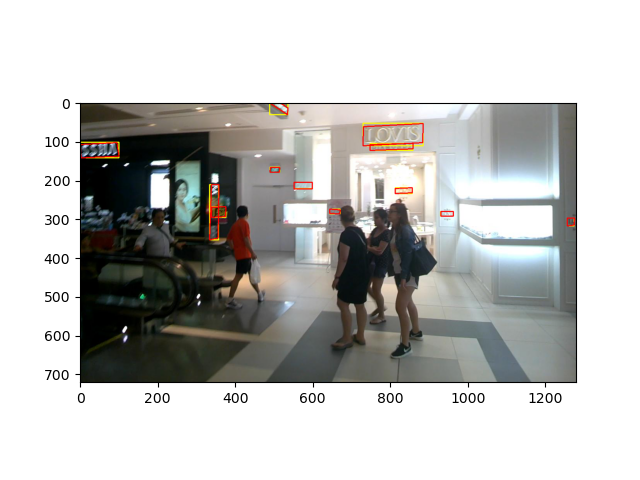

['###', 'South', 'L14', '#14-01', '#14-03', 'Tower', '###', '###', '###', '###', '###']
tensor([[0.8059, 0.3646, 0.0477, 0.0375],
        [0.7898, 0.0625, 0.0484, 0.0500],
        [0.8043, 0.1451, 0.0758, 0.0819],
        [0.8008, 0.2688, 0.0484, 0.0319],
        [0.8043, 0.3181, 0.0477, 0.0333],
        [0.8430, 0.0479, 0.0562, 0.0514],
        [0.8340, 0.2729, 0.0148, 0.0264],
        [0.8371, 0.3229, 0.0180, 0.0264],
        [0.8539, 0.2694, 0.0219, 0.0361],
        [0.8570, 0.3236, 0.0234, 0.0306],
        [0.0957, 0.0167, 0.0383, 0.0306]])


<IPython.core.display.Javascript object>


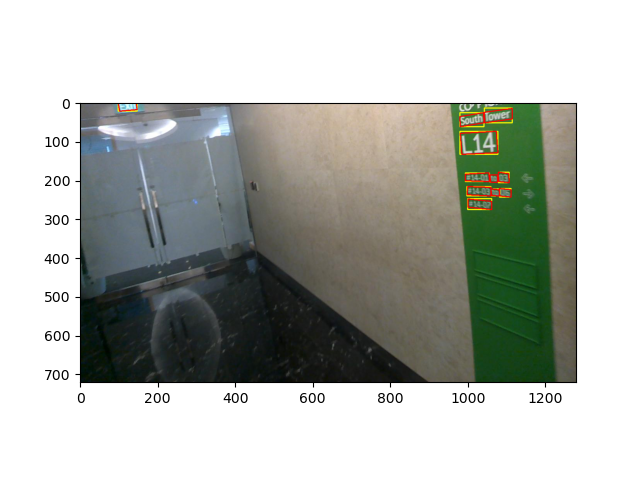

['SIMMONS']
tensor([[0.6258, 0.2007, 0.1156, 0.1208]])


<IPython.core.display.Javascript object>


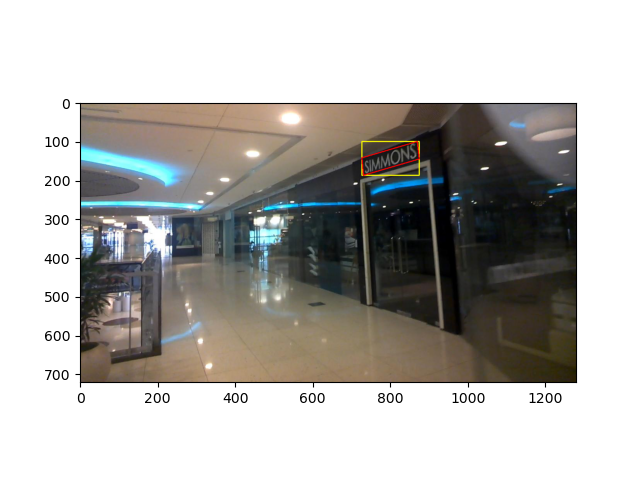

['cache', 'cache', 'cache', 'cocho', 'cache', '###', '###', '###', '###']
tensor([[0.3641, 0.2153, 0.1031, 0.0833],
        [0.4961, 0.1701, 0.1016, 0.0792],
        [0.6277, 0.4104, 0.0367, 0.1542],
        [0.6090, 0.1972, 0.0289, 0.1556],
        [0.2406, 0.3333, 0.0812, 0.0528],
        [0.6566, 0.6847, 0.0586, 0.3750],
        [0.5074, 0.9340, 0.2352, 0.1264],
        [0.0437, 0.6431, 0.0797, 0.1222],
        [0.0227, 0.5840, 0.0422, 0.0875]])


<IPython.core.display.Javascript object>


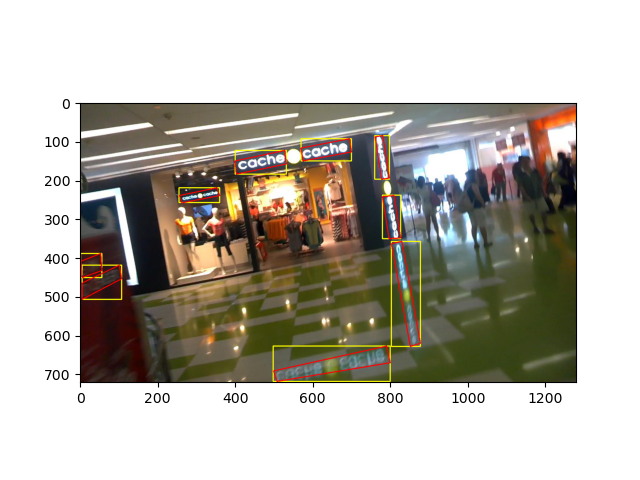

['Grand', 'Grand', 'Anniversary', 'Anniversary', 'SALE', 'SALE', 'colectpoint', 'SALE', '###', '###', '###', '###', '###']
tensor([[0.4133, 0.1118, 0.0734, 0.0569],
        [0.5672, 0.0639, 0.0828, 0.0722],
        [0.4160, 0.1431, 0.1273, 0.0722],
        [0.5695, 0.0951, 0.1500, 0.0903],
        [0.4184, 0.2021, 0.1352, 0.1153],
        [0.5734, 0.1653, 0.1562, 0.1361],
        [0.4688, 0.3111, 0.0797, 0.0889],
        [0.7477, 0.3986, 0.0328, 0.0333],
        [0.7832, 0.3903, 0.0383, 0.0417],
        [0.7473, 0.3715, 0.0336, 0.0319],
        [0.7836, 0.3604, 0.0344, 0.0375],
        [0.4918, 0.4486, 0.0648, 0.0194],
        [0.7285, 0.5444, 0.0367, 0.0278]])


<IPython.core.display.Javascript object>


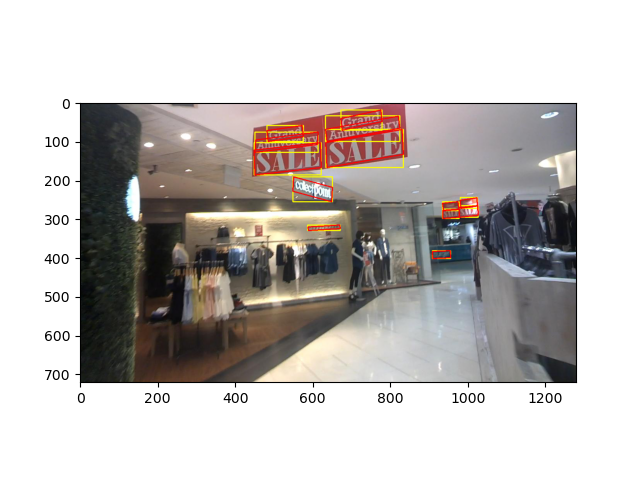

['E-PAY', 'AXS', '###', '###', '###']
tensor([[0.6645, 0.1715, 0.1852, 0.1764],
        [0.6363, 0.4549, 0.0508, 0.0292],
        [0.2586, 0.4000, 0.1094, 0.1000],
        [0.5461, 0.4479, 0.0328, 0.0125],
        [0.5457, 0.4590, 0.0336, 0.0125]])


<IPython.core.display.Javascript object>


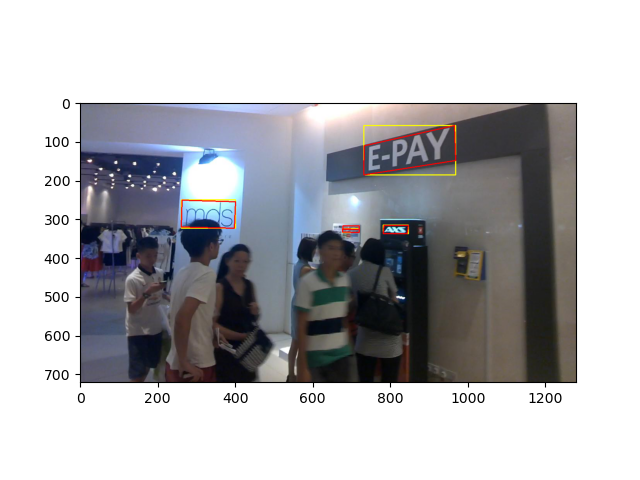

['System', 'map']
tensor([[0.6812, 0.0701, 0.0437, 0.0403],
        [0.7203, 0.0611, 0.0328, 0.0361]])


<IPython.core.display.Javascript object>

['###', '###', '###', 'NEW', 'TRADITION', 'CELEBRATE', '###', '###', '###', '###', '###']
tensor([[0.1844, 0.1375, 0.0812, 0.0361],
        [0.4660, 0.1590, 0.0539, 0.0514],
        [0.5980, 0.2688, 0.0148, 0.0292],
        [0.6168, 0.2590, 0.0336, 0.0347],
        [0.6301, 0.2812, 0.0727, 0.0486],
        [0.6230, 0.2292, 0.0711, 0.0528],
        [0.6051, 0.1361, 0.0211, 0.0222],
        [0.6117, 0.1465, 0.0344, 0.0292],
        [0.6488, 0.3056, 0.1023, 0.0444],
        [0.6270, 0.3701, 0.0492, 0.0431],
        [0.7844, 0.0875, 0.0609, 0.0333]])


<IPython.core.display.Javascript object>


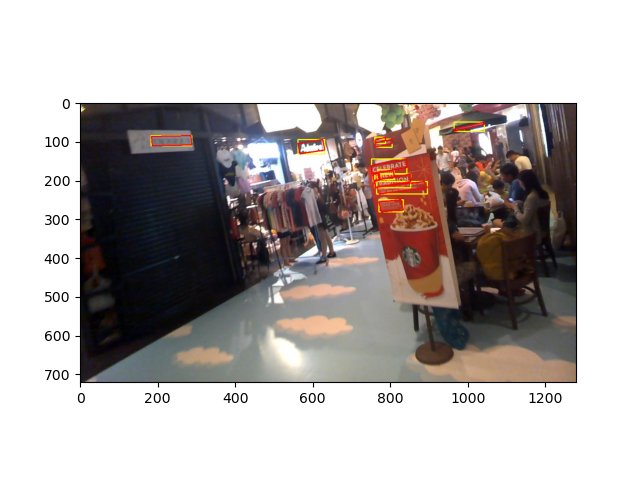

['###', '###', 'ACCENT', '###', '###']
tensor([[0.1520, 0.4563, 0.1039, 0.0681],
        [0.3410, 0.1681, 0.0539, 0.0694],
        [0.4254, 0.1931, 0.0883, 0.0667],
        [0.8312, 0.1618, 0.0516, 0.0236],
        [0.7879, 0.2681, 0.0273, 0.0639]])


<IPython.core.display.Javascript object>


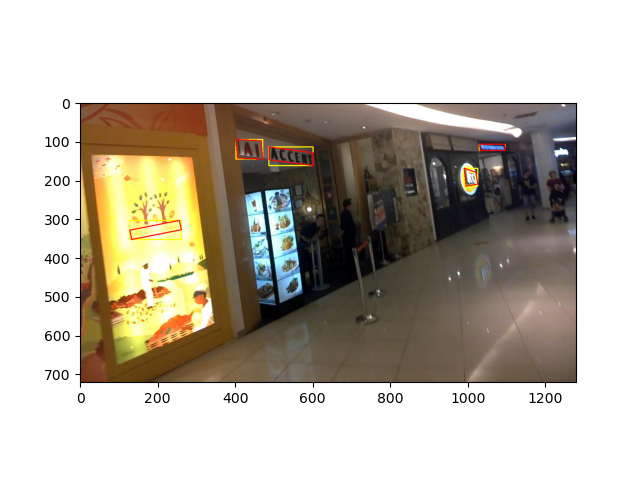

['Minor', '###', 'ENVIRONMENTAL', 'SUSTAINABILITY', '###', '###', '###', '###', '###', '###', '###', '###']
tensor([[0.3379, 0.8306, 0.0258, 0.0222],
        [0.3559, 0.8257, 0.0102, 0.0208],
        [0.3070, 0.8583, 0.0766, 0.0417],
        [0.3797, 0.8354, 0.0719, 0.0403],
        [0.3027, 0.8826, 0.0211, 0.0181],
        [0.3211, 0.8764, 0.0125, 0.0167],
        [0.3363, 0.8708, 0.0195, 0.0194],
        [0.3570, 0.8646, 0.0234, 0.0208],
        [0.3730, 0.8597, 0.0102, 0.0167],
        [0.3871, 0.8549, 0.0195, 0.0181],
        [0.9793, 0.4319, 0.0367, 0.0583],
        [0.9527, 0.4361, 0.0227, 0.0278]])


<IPython.core.display.Javascript object>

['STORY', 'GAIN', 'CITY', '###', '###', '###', '###']
tensor([[0.1355, 0.5882, 0.1258, 0.0847],
        [0.6352, 0.1979, 0.0594, 0.1014],
        [0.6992, 0.1403, 0.0766, 0.1278],
        [0.9465, 0.5764, 0.1008, 0.0722],
        [0.6730, 0.4153, 0.0383, 0.0333],
        [0.7531, 0.4451, 0.0328, 0.0319],
        [0.7918, 0.4597, 0.0383, 0.0417]])


<IPython.core.display.Javascript object>


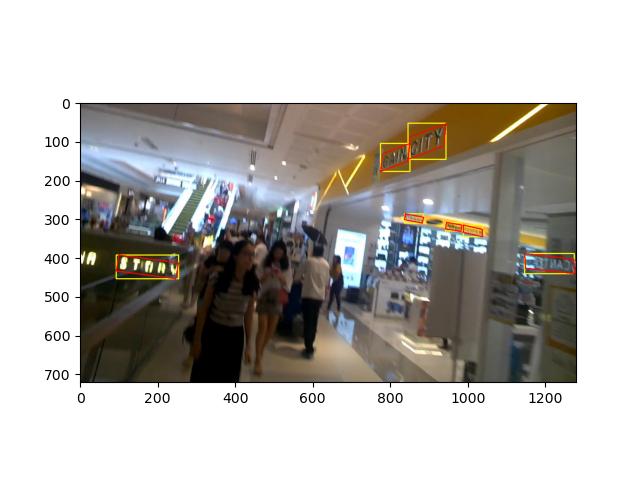

['Stationery', 'Event', '###', 'the', 'Year!', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', 'cashier']
tensor([[0.4746, 0.0451, 0.1102, 0.0514],
        [0.4461, 0.0840, 0.0516, 0.0347],
        [0.4875, 0.0799, 0.0219, 0.0431],
        [0.4359, 0.1236, 0.0297, 0.0361],
        [0.4801, 0.1222, 0.0492, 0.0389],
        [0.5527, 0.6562, 0.0133, 0.0347],
        [0.5516, 0.6965, 0.0125, 0.0375],
        [0.5523, 0.7375, 0.0125, 0.0333],
        [0.6105, 0.1201, 0.0477, 0.0403],
        [0.6660, 0.1132, 0.0508, 0.0431],
        [0.7238, 0.1167, 0.0461, 0.0361],
        [0.5852, 0.0868, 0.0250, 0.0264],
        [0.6621, 0.1597, 0.0477, 0.0111],
        [0.7762, 0.1104, 0.0367, 0.0431],
        [0.6582, 0.0215, 0.0664, 0.0319],
        [0.7555, 0.0174, 0.0344, 0.0264

<IPython.core.display.Javascript object>


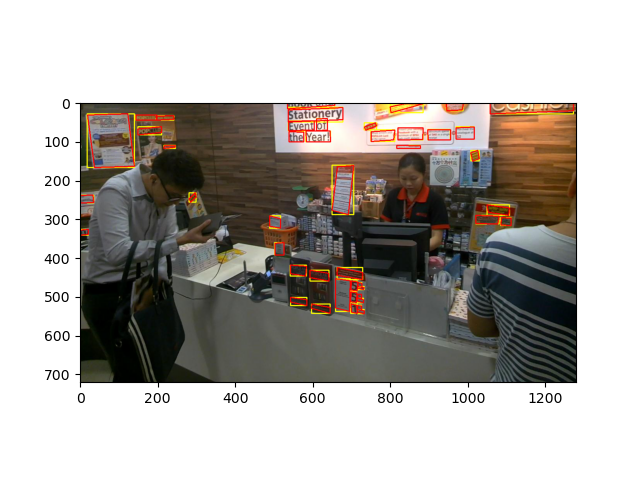

['MARKS', '###', 'SPENCER', 'sale', '###', '###']
tensor([[0.6781, 0.2653, 0.0609, 0.0500],
        [0.7168, 0.2549, 0.0148, 0.0375],
        [0.7719, 0.2354, 0.0953, 0.0653],
        [0.7754, 0.6389, 0.0445, 0.0472],
        [0.6375, 0.5778, 0.0625, 0.0333],
        [0.4766, 0.3424, 0.0297, 0.0292]])


<IPython.core.display.Javascript object>

['###', 'SERC', 'Services', '###', '###', 'Shared', '###', '###', '###', '###', '###']
tensor([[0.6363, 0.6049, 0.0836, 0.0792],
        [0.5359, 0.1639, 0.0813, 0.1556],
        [0.5418, 0.3139, 0.0805, 0.1083],
        [0.5293, 0.0597, 0.0789, 0.1194],
        [0.3020, 0.3521, 0.0633, 0.1042],
        [0.5387, 0.2389, 0.0805, 0.1250],
        [0.7496, 0.5951, 0.0289, 0.0514],
        [0.7766, 0.5847, 0.0188, 0.0250],
        [0.1531, 0.4625, 0.0172, 0.0222],
        [0.5531, 0.3868, 0.0469, 0.0597],
        [0.5688, 0.5646, 0.0328, 0.0514]])


<IPython.core.display.Javascript object>


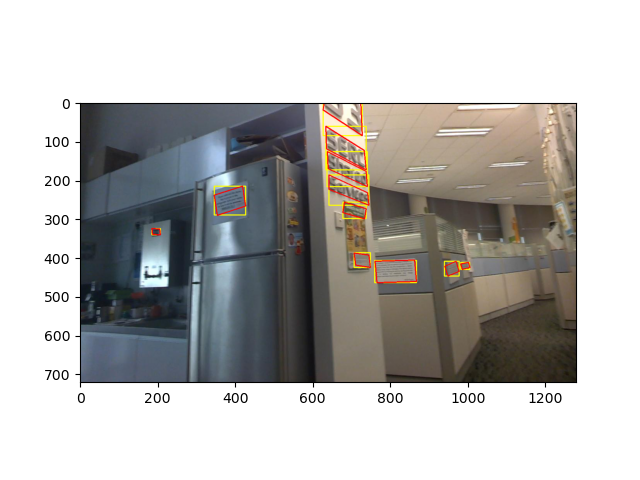

['###', '###', '###', 'Sleep', 'Clinic', 'Bedding', '###', 'Furniture', '###', '###', '###', '###', '###', '###', 'SAMSUNG', '###', '###', '28.888', '###', 'Upgrade', 'and', 'Shopping', '###', '###', '###', '###', 'ECO', 'full-flat', 'Vouchers', '###']
tensor([[0.5543, 0.3736, 0.0258, 0.0222],
        [0.5379, 0.4896, 0.0305, 0.0347],
        [0.4086, 0.2521, 0.0141, 0.0236],
        [0.6910, 0.1063, 0.0367, 0.0375],
        [0.7273, 0.0889, 0.0375, 0.0417],
        [0.4371, 0.2424, 0.0445, 0.0347],
        [0.2598, 0.5007, 0.0258, 0.0236],
        [0.3789, 0.2618, 0.0484, 0.0375],
        [0.2914, 0.5278, 0.0359, 0.0333],
        [0.4383, 0.4507, 0.0234, 0.0236],
        [0.5281, 0.1917, 0.0391, 0.0306],
        [0.5320, 0.2188, 0.0281, 0.0264],
        [0.4633, 0.2750, 0.0609, 0.0333],
        [0.6121, 0.4278, 0.0195, 0.0278],
        [0.6461, 0.6097, 0.0250, 0.1028],
        [0.7063, 0.5250, 0.0172, 0.0778],
        [0.7270, 0.4882, 0.0180, 0.0736],
        [0.0898, 0.1076, 0.1016, 

<IPython.core.display.Javascript object>


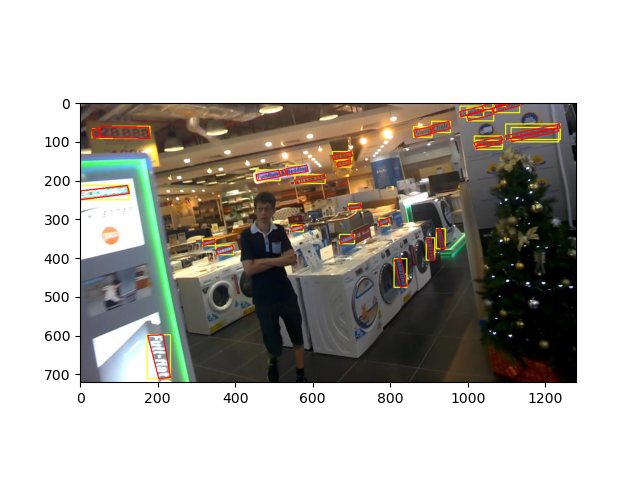

In [8]:
indices = np.random.randint(0, len(train_dataset), 15)

for index in indices:
    img, targets, texts = train_dataset[index]
    
    locs, quads = targets[:, :4], targets[:, 4:12]
    
    print(texts)
    print(locs)
    img = toVisualizeRectRGBimg(img, locs, rgb=(255,255,0), verbose=False)# yellow
    img = toVisualizeQuadsRGBimg(torch.from_numpy(img.transpose((2, 0, 1)) / 255.), quads, verbose=False)# red

    plt.figure()
    plt.imshow(img)

# Focused Scene Text

In [9]:
target_transform = target_transforms.Compose(
    [target_transforms.Corners2Centroids(),
     #target_transforms.ToQuadrilateral(),
     target_transforms.ToTensor()]
)
train_dataset = datasets.ICDARFocusedSceneTextDataset(ignore=None, transform=transform, target_transform=target_transform, augmentation=None)

['SANYO', 'PROxtraX', 'MULTIMEDIA', 'PROJECTOR']
tensor([[0.5227, 0.1792, 0.4859, 0.2042],
        [0.5117, 0.7375, 0.4547, 0.1042],
        [0.4039, 0.8219, 0.2266, 0.0312],
        [0.6336, 0.8219, 0.2047, 0.0312]])


/home/kado/.pyenv/versions/anaconda3-2019.07/envs/dl/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]


<IPython.core.display.Javascript object>


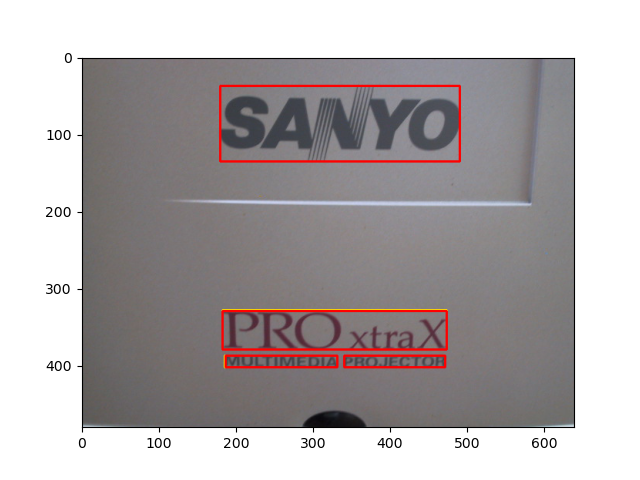

['FREEDOM', '###']
tensor([[0.5813, 0.8648, 0.3292, 0.0672],
        [0.6115, 0.3805, 0.0646, 0.0734]])


<IPython.core.display.Javascript object>


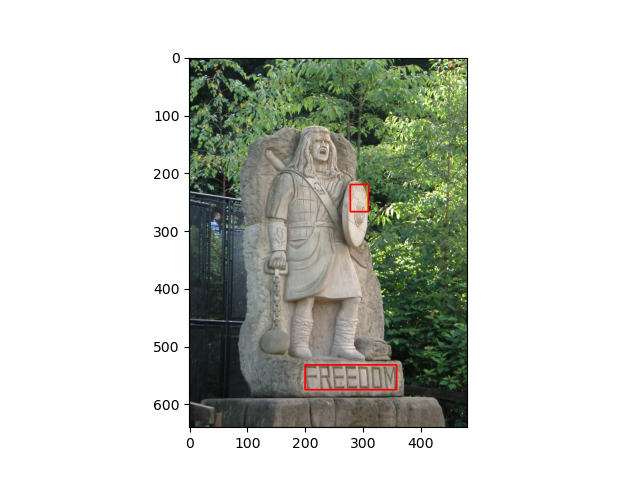

['ORDER', 'YOUR', 'ISUZU']
tensor([[0.3852, 0.6687, 0.2359, 0.1250],
        [0.6320, 0.6698, 0.1891, 0.1229],
        [0.5234, 0.3271, 0.6469, 0.1583]])


<IPython.core.display.Javascript object>


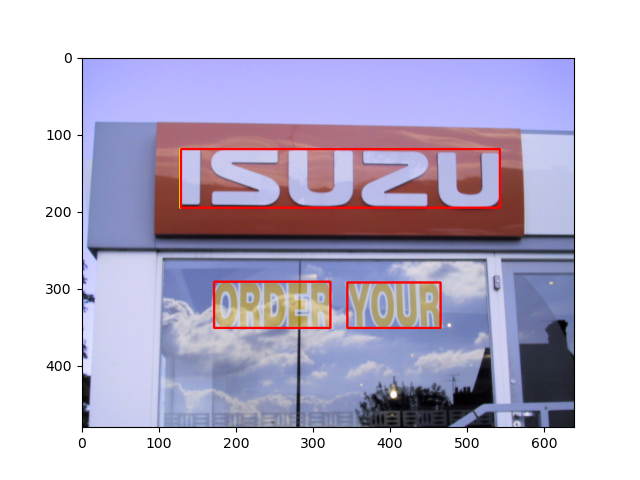

['J2SE', '###', '###']
tensor([[0.4797, 0.4365, 0.9000, 0.4021],
        [0.2203, 0.9021, 0.4406, 0.1917],
        [0.7648, 0.9021, 0.4672, 0.1917]])


<IPython.core.display.Javascript object>


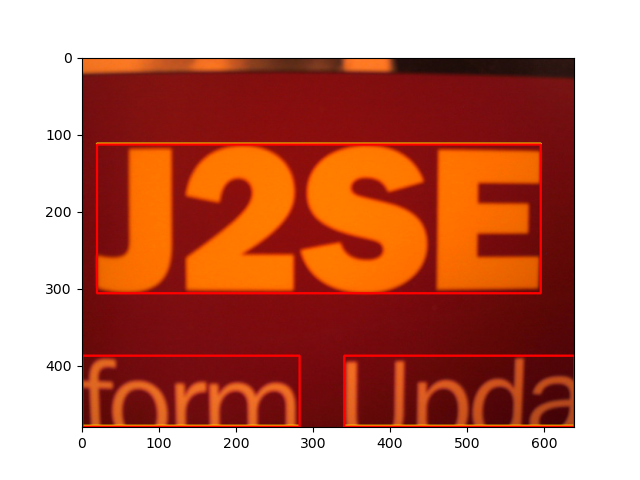

['Rayleigh']
tensor([[0.5344, 0.4198, 0.5469, 0.1479]])


<IPython.core.display.Javascript object>


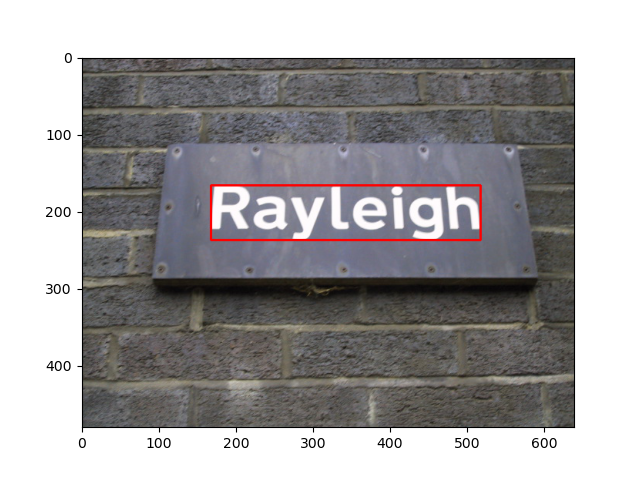

['Colchester']
tensor([[0.5039, 0.4062, 0.2539, 0.0547]])


<IPython.core.display.Javascript object>


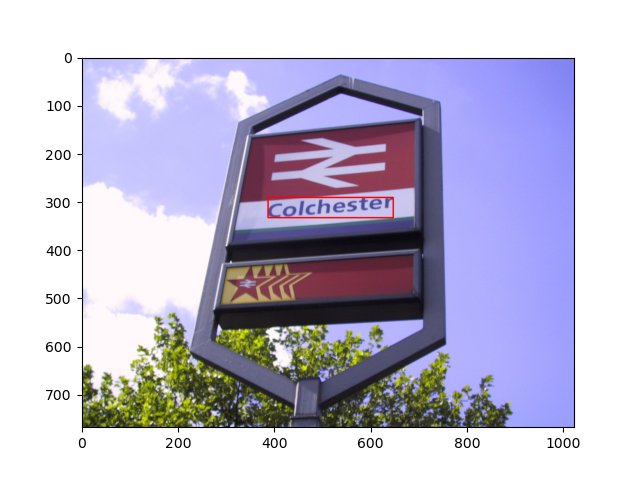

['Sun', 'microsystems']
tensor([[0.5144, 0.3108, 0.2479, 0.1771],
        [0.5161, 0.4344, 0.2343, 0.0486]])


<IPython.core.display.Javascript object>


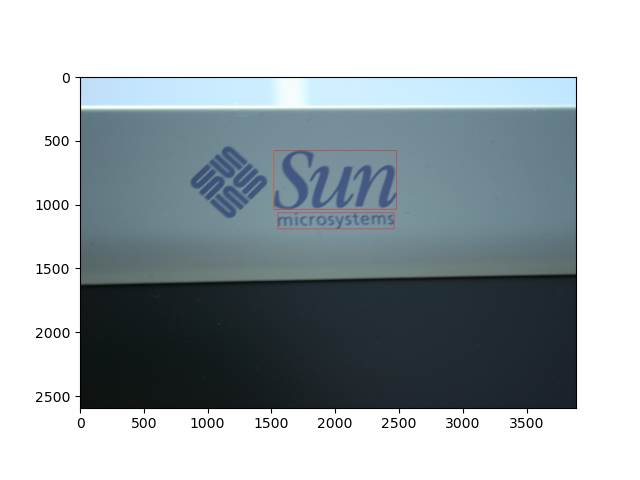

['www.b4valu', '###', '###', '###', '###']
tensor([[0.6508, 0.7542, 0.6073, 0.1381],
        [0.1271, 0.2562, 0.2541, 0.5123],
        [0.4938, 0.2654, 0.3374, 0.5309],
        [0.9803, 0.7716, 0.0388, 0.1049],
        [0.8355, 0.1364, 0.0903, 0.2728]])


<IPython.core.display.Javascript object>


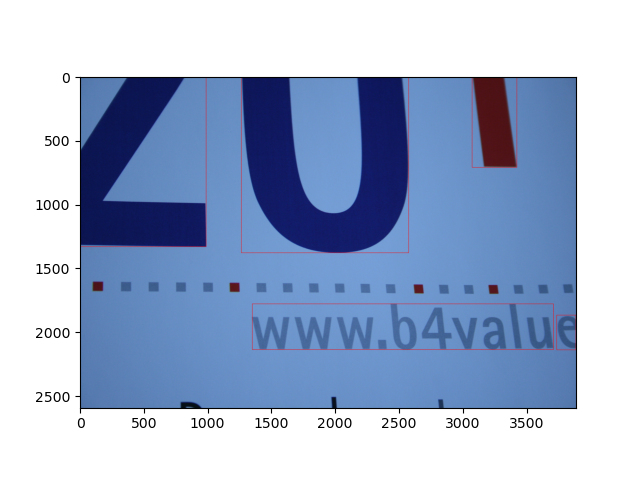

['CONSTANTINE', '###', '###', '###', '###', '###']
tensor([[0.5023, 0.4014, 0.8609, 0.2548],
        [0.1117, 0.0072, 0.0359, 0.0144],
        [0.0922, 0.0361, 0.0312, 0.0144],
        [0.1266, 0.0361, 0.0344, 0.0144],
        [0.1961, 0.0457, 0.0328, 0.0433],
        [0.2430, 0.0409, 0.0328, 0.0433]])


<IPython.core.display.Javascript object>


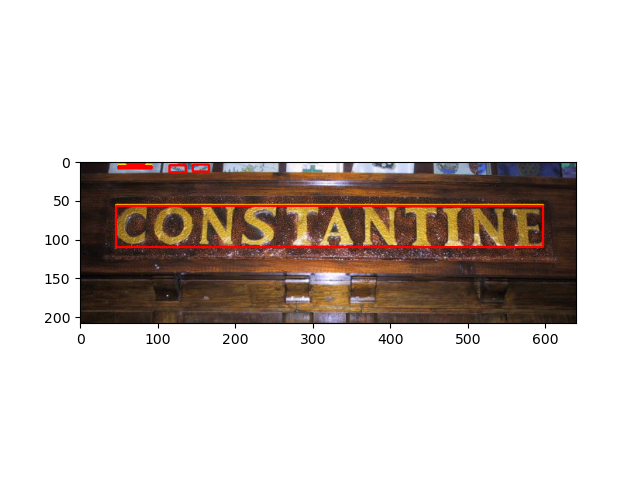

['1.21', '###', 'floor', 'RICOH', 'IESE', '###']
tensor([[0.6499, 0.0797, 0.0442, 0.0482],
        [0.0225, 0.0532, 0.0280, 0.0455],
        [0.0877, 0.0519, 0.0787, 0.0482],
        [0.3495, 0.4361, 0.5761, 0.1771],
        [0.3392, 0.9062, 0.0694, 0.0409],
        [0.1334, 0.9902, 0.1921, 0.0189]])


<IPython.core.display.Javascript object>


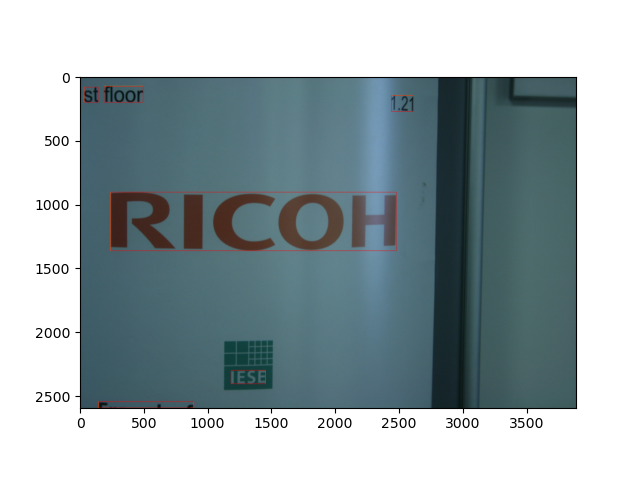

['Knowledge', 'Management', '(KM)', '2.10', 'Oleg', 'Rostanin', 'Asif', 'Shahab']
tensor([[0.4142, 0.0376, 0.0820, 0.0235],
        [0.5109, 0.0386, 0.0980, 0.0224],
        [0.5831, 0.0388, 0.0345, 0.0235],
        [0.2487, 0.4149, 0.0190, 0.0112],
        [0.4406, 0.2338, 0.0602, 0.0424],
        [0.5370, 0.2294, 0.1121, 0.0336],
        [0.4669, 0.3092, 0.0502, 0.0343],
        [0.5485, 0.3083, 0.0959, 0.0347]])


<IPython.core.display.Javascript object>


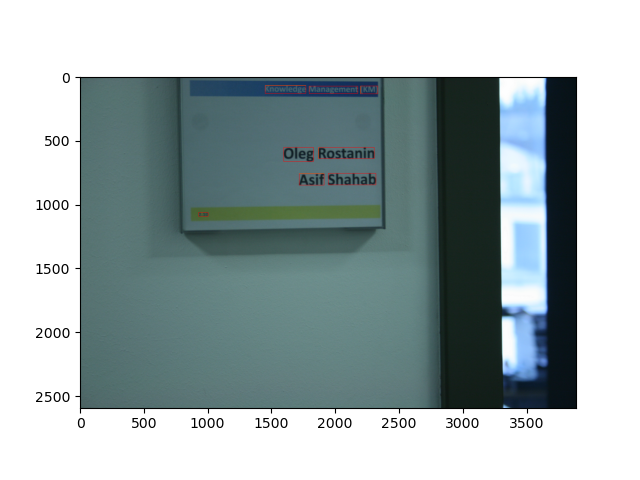

['Please', 'lock', 'the', 'gate']
tensor([[0.4641, 0.3240, 0.3344, 0.1062],
        [0.4633, 0.4771, 0.2047, 0.1000],
        [0.3430, 0.6250, 0.1516, 0.0958],
        [0.5562, 0.6385, 0.2031, 0.1188]])


<IPython.core.display.Javascript object>


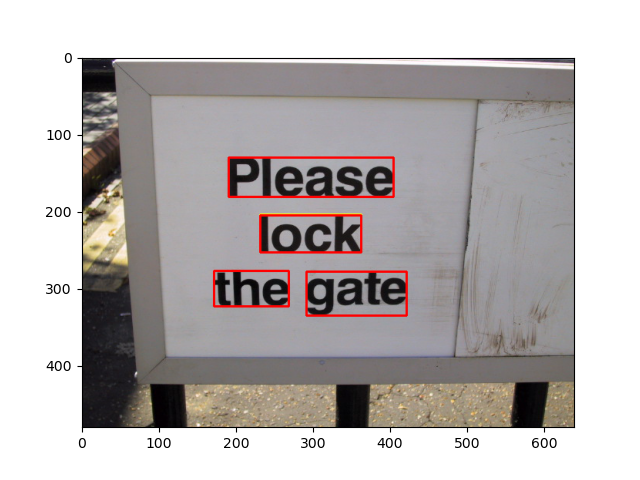

['###', 'admittance', 'Authorised', 'Personnel', 'only']
tensor([[0.4422, 0.4083, 0.0969, 0.0750],
        [0.7234, 0.4062, 0.4094, 0.0792],
        [0.6578, 0.5250, 0.4062, 0.0792],
        [0.5695, 0.6562, 0.3641, 0.1000],
        [0.8602, 0.6531, 0.1547, 0.0979]])


<IPython.core.display.Javascript object>


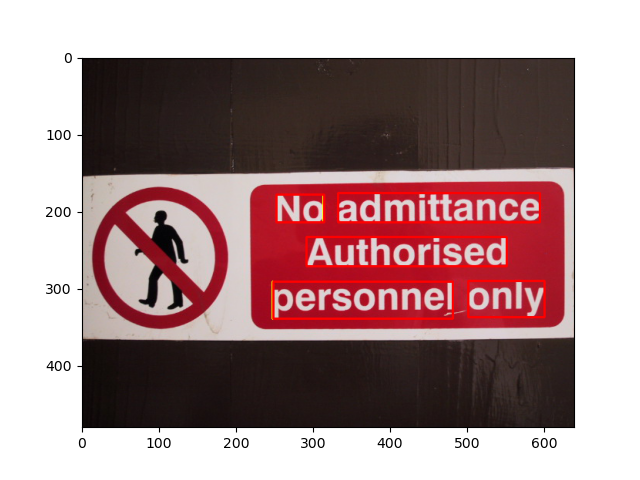

['SMIRNOFF', '###']
tensor([[0.7418, 0.8807, 0.2711, 0.0990],
        [0.7406, 0.6661, 0.0969, 0.0510]])


<IPython.core.display.Javascript object>


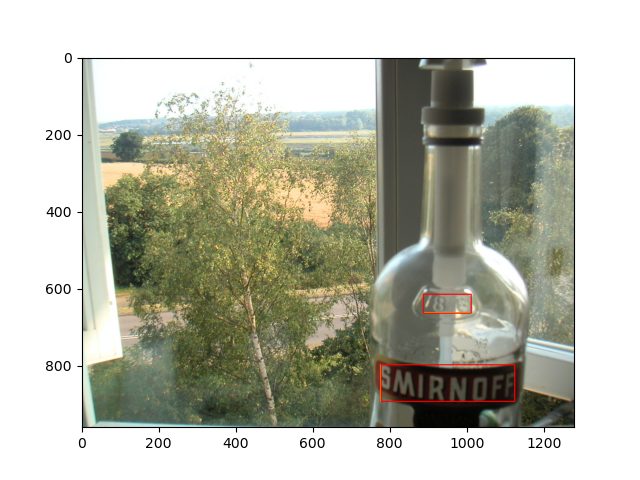

['###', '###', 'Cable', 'DLR-3P', 'A4382', 'Nokia', '6210', 'DLR-3P', 'Data', 'Cable', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', 'KIA', 'apter']
tensor([[0.4641, 0.2113, 0.0844, 0.0875],
        [0.4688, 0.3079, 0.0100, 0.0242],
        [0.5744, 0.3083, 0.0600, 0.0283],
        [0.6553, 0.3096, 0.0794, 0.0275],
        [0.4147, 0.4342, 0.0744, 0.0283],
        [0.3969, 0.4967, 0.0400, 0.0167],
        [0.3931, 0.5371, 0.0375, 0.0175],
        [0.4034, 0.5771, 0.0581, 0.0175],
        [0.4556, 0.5800, 0.0325, 0.0167],
        [0.4994, 0.5821, 0.0425, 0.0175],
        [0.7400, 0.8625, 0.1838, 0.1183],
        [0.7069, 0.9592, 0.2475, 0.0800],
        [0.7884, 0.7262, 0.0956, 0.1575],
        [0.7363, 0.4392, 0.2063, 0.1233],
        [0.6872, 0.5558, 0.2581, 0.1217],
        [0.5362, 0.7892, 0.2600, 0.1767],
        [0.6191, 0.6596, 0.2531, 0.1625],
        [0.4553, 0.9200, 0.2794, 0.1567],
        [0.3475, 0.6075, 0.2163, 0.1517],
        

<IPython.core.display.Javascript object>


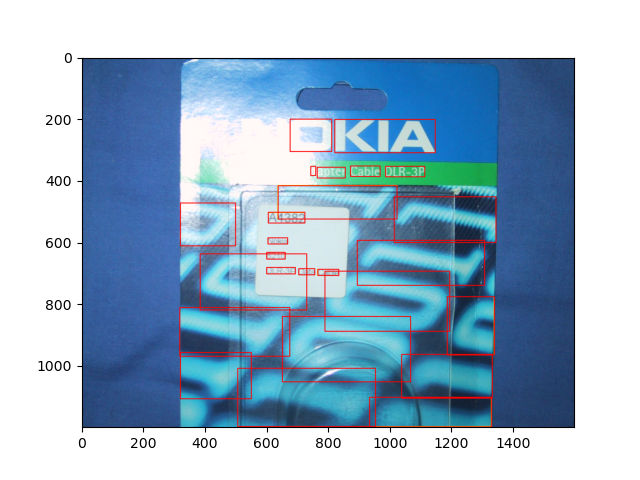

In [10]:
indices = np.random.randint(0, len(train_dataset), 15)

for index in indices:
    img, targets, texts = train_dataset[index]
    
    locs, quads = targets[:, :4], targets[:, 4:12]
    
    print(texts)
    print(locs)
    img = toVisualizeRectRGBimg(img, locs, rgb=(255,255,0), verbose=False)# yellow
    img = toVisualizeQuadsRGBimg(torch.from_numpy(img.transpose((2, 0, 1)) / 255.), quads, verbose=False)# red

    plt.figure()
    plt.imshow(img)

# Born Digital Images

In [11]:
target_transform = target_transforms.Compose(
    [target_transforms.Corners2Centroids(),
     target_transforms.ToQuadrilateral(),
     target_transforms.ToTensor()]
)
train_dataset = datasets.ICDARBornDigitalTextDataset(ignore=None, transform=transform, target_transform=target_transform, augmentation=None)

['NOW', '###', 'HALF', 'PRICE', 'SALE', 'Sale', 'ends', '21st', 'Jan.', 'Click', 'here', 'for', 'all', 'sale', 'items']
tensor([[0.0701, 0.2315, 0.1015, 0.2062],
        [0.1664, 0.0992, 0.0642, 0.1362],
        [0.2679, 0.3327, 0.1627, 0.1206],
        [0.2500, 0.5350, 0.1955, 0.1206],
        [0.5970, 0.4397, 0.4388, 0.3424],
        [0.8090, 0.7704, 0.0448, 0.0778],
        [0.8627, 0.6984, 0.0478, 0.0817],
        [0.9134, 0.6226, 0.0448, 0.0856],
        [0.9634, 0.5642, 0.0403, 0.0700],
        [0.3179, 0.9202, 0.0746, 0.0661],
        [0.4045, 0.9202, 0.0687, 0.0661],
        [0.4739, 0.9202, 0.0433, 0.0661],
        [0.5269, 0.9202, 0.0358, 0.0661],
        [0.5903, 0.9202, 0.0612, 0.0661],
        [0.6769, 0.9202, 0.0851, 0.0661]])


/home/kado/.pyenv/versions/anaconda3-2019.07/envs/dl/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]


<IPython.core.display.Javascript object>


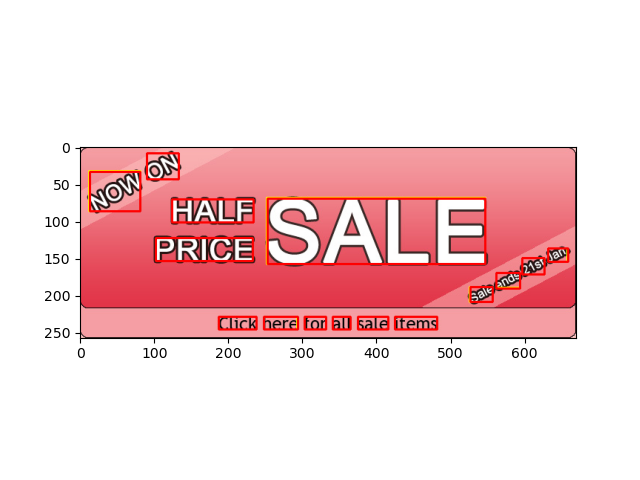

['stayAmsterdam.com', 'Studios', 'from', '€59', 'per', 'night', '(sleeps', '###', '###', '###', '30%', 'OFF', '###', 'selected', 'apartments.', 'Book', 'now', '###']
tensor([[0.6782, 0.0738, 0.5091, 0.1007],
        [0.1191, 0.8104, 0.1000, 0.0436],
        [0.2118, 0.8104, 0.0636, 0.0436],
        [0.2827, 0.8121, 0.0527, 0.0403],
        [0.3445, 0.8238, 0.0455, 0.0436],
        [0.4136, 0.8188, 0.0709, 0.0537],
        [0.4900, 0.8221, 0.0600, 0.0336],
        [0.5364, 0.8221, 0.0145, 0.0268],
        [0.0809, 0.8926, 0.0273, 0.0403],
        [0.1136, 0.8876, 0.0200, 0.0302],
        [0.1555, 0.8876, 0.0455, 0.0302],
        [0.2073, 0.8876, 0.0400, 0.0302],
        [0.2482, 0.8909, 0.0236, 0.0235],
        [0.3155, 0.8876, 0.0891, 0.0302],
        [0.4345, 0.8926, 0.1309, 0.0403],
        [0.7845, 0.8775, 0.0600, 0.0369],
        [0.8527, 0.8826, 0.0509, 0.0268],
        [0.9045, 0.8792, 0.0236, 0.0268]])


<IPython.core.display.Javascript object>


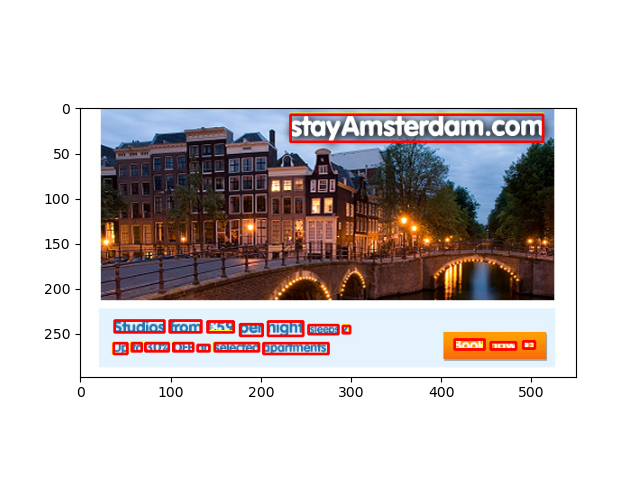

['visit', 'the', 'BRITISH', 'COUNCIL', 'COLLECTION', 'online']
tensor([[0.3744, 0.3619, 0.0955, 0.0762],
        [0.4849, 0.3619, 0.0754, 0.0762],
        [0.5603, 0.5190, 0.2161, 0.0857],
        [0.8266, 0.5190, 0.2563, 0.0857],
        [0.7035, 0.6714, 0.5025, 0.1238],
        [0.8819, 0.8381, 0.1457, 0.0762]])


<IPython.core.display.Javascript object>


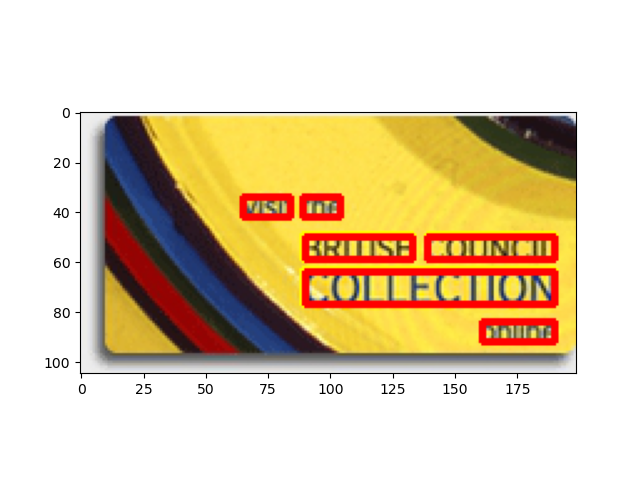

['313-262-2010', '2010', 'HOME', 'OPPONENTS', '###', '###', '###']
tensor([[0.6921, 0.0829, 0.3322, 0.1326],
        [0.6324, 0.3674, 0.0284, 0.0387],
        [0.6714, 0.3674, 0.0355, 0.0387],
        [0.7358, 0.3674, 0.0792, 0.0387],
        [0.2470, 0.4945, 0.0638, 0.5359],
        [0.4592, 0.5525, 0.0390, 0.1215],
        [0.5225, 0.5525, 0.0426, 0.1215]])


<IPython.core.display.Javascript object>


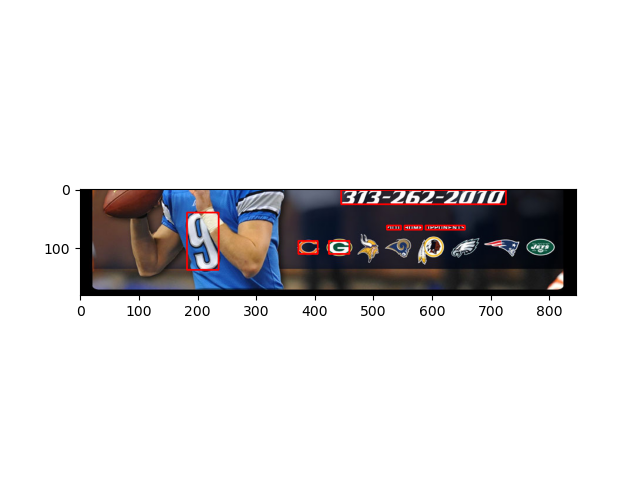

['Men', 'Women', 'Boys', 'Girls', 'Baby']
tensor([[0.1123, 0.3220, 0.1390, 0.0791],
        [0.1684, 0.4718, 0.2513, 0.0734],
        [0.1150, 0.6356, 0.1444, 0.1073],
        [0.1096, 0.7684, 0.1337, 0.0791],
        [0.1203, 0.9294, 0.1551, 0.1073]])


<IPython.core.display.Javascript object>


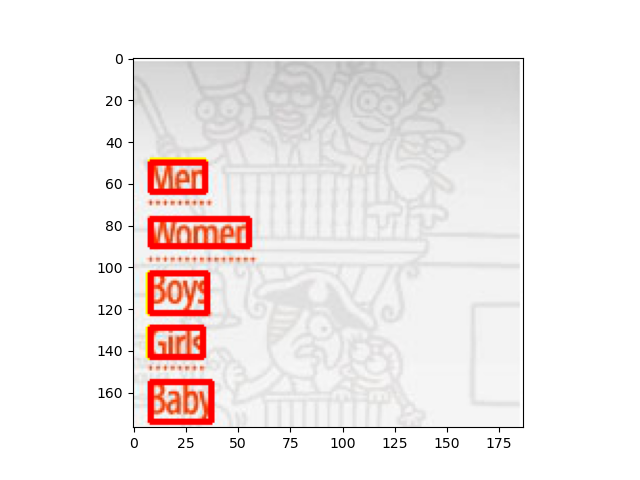

['Wishing', 'all', 'our', 'guests', '###', 'very', 'Merry', 'Christmas', 'and', '###', 'prosperous', 'New', 'Year!', 'From', 'all', '###', 'Stay', 'City', '.com', 'Oxfam', 'This', 'Christmas', '###', 'support', 'and', 'their', 'work', '###', 'relieve', '', 'distress', 'and', 'suffering', '###', 'some', '###', 'the', 'poorest', 'countries', '###', 'the', 'world.']
tensor([[0.6092, 0.3247, 0.1483, 0.0795],
        [0.7133, 0.3137, 0.0333, 0.0575],
        [0.7750, 0.3315, 0.0600, 0.0274],
        [0.8717, 0.3370, 0.1200, 0.0603],
        [0.5258, 0.4068, 0.0183, 0.0247],
        [0.5842, 0.4205, 0.0717, 0.0521],
        [0.6925, 0.4055, 0.1117, 0.0822],
        [0.8567, 0.3973, 0.1867, 0.0712],
        [0.6067, 0.4699, 0.0633, 0.0575],
        [0.6633, 0.4836, 0.0167, 0.0247],
        [0.7892, 0.4986, 0.2050, 0.0548],
        [0.6775, 0.5507, 0.0817, 0.0658],
        [0.7825, 0.5507, 0.1017, 0.0658],
        [0.7233, 0.6918, 0.0633, 0.0466],
        [0.7783, 0.6877, 0.0233, 0.0384],
    

<IPython.core.display.Javascript object>


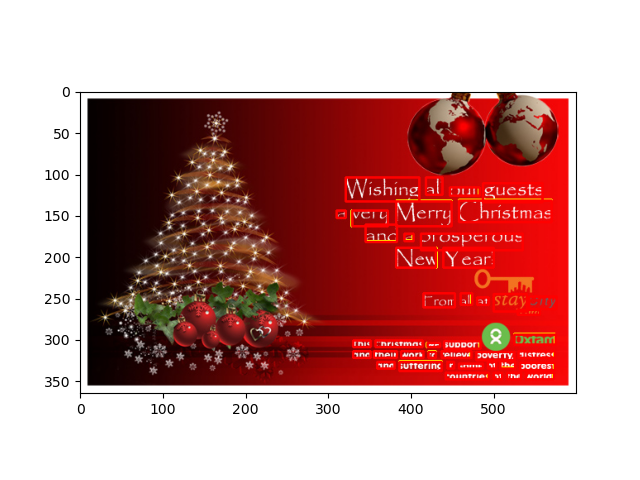

['LIBERTY', 'Ford', 'NORTHEAST', "OHIO'S", '###', 'FORD', 'DEALER', 'GROUP', 'Ford']
tensor([[0.4943, 0.1531, 0.8971, 0.2187],
        [0.5657, 0.2969, 0.2057, 0.1062],
        [0.3400, 0.4875, 0.3943, 0.0625],
        [0.6771, 0.4875, 0.2114, 0.0625],
        [0.8400, 0.4875, 0.0571, 0.0625],
        [0.2343, 0.5844, 0.1714, 0.0563],
        [0.4829, 0.5844, 0.2571, 0.0563],
        [0.7543, 0.5844, 0.2286, 0.0563],
        [0.5600, 0.2937, 0.1829, 0.0750]])


<IPython.core.display.Javascript object>


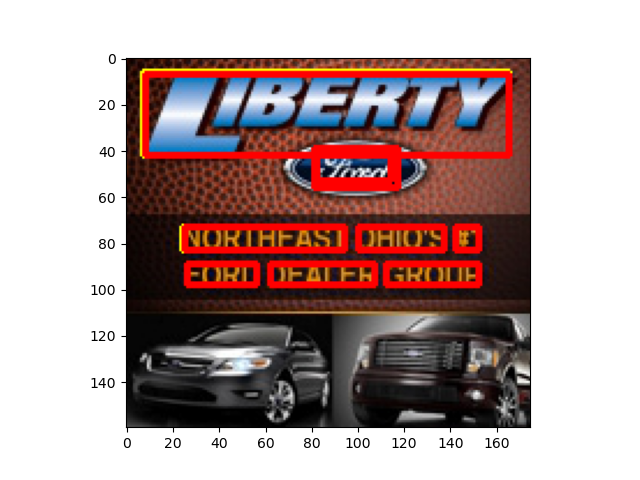

['2009', 'ADVENT', 'CALENDAR', 'Guess', "today's", 'mystery', 'product', 'and', 'stand', '###', 'chance', '###', 'WIN', 'it!', 'MORE', 'INFO']
tensor([[0.1218, 0.0943, 0.1827, 0.0943],
        [0.3883, 0.0943, 0.2995, 0.0943],
        [0.7665, 0.0943, 0.4061, 0.0943],
        [0.6675, 0.2500, 0.1269, 0.0849],
        [0.8325, 0.2642, 0.1624, 0.1132],
        [0.6574, 0.3962, 0.1878, 0.0943],
        [0.8655, 0.3821, 0.1777, 0.1038],
        [0.6574, 0.5047, 0.0863, 0.0849],
        [0.7843, 0.5047, 0.1269, 0.0849],
        [0.8782, 0.5189, 0.0203, 0.0566],
        [0.6396, 0.6368, 0.1624, 0.0849],
        [0.7589, 0.6462, 0.0457, 0.0660],
        [0.8477, 0.6368, 0.0914, 0.0849],
        [0.9365, 0.6368, 0.0457, 0.0849],
        [0.6497, 0.8632, 0.2132, 0.0849],
        [0.8756, 0.8632, 0.1675, 0.0849]])


<IPython.core.display.Javascript object>


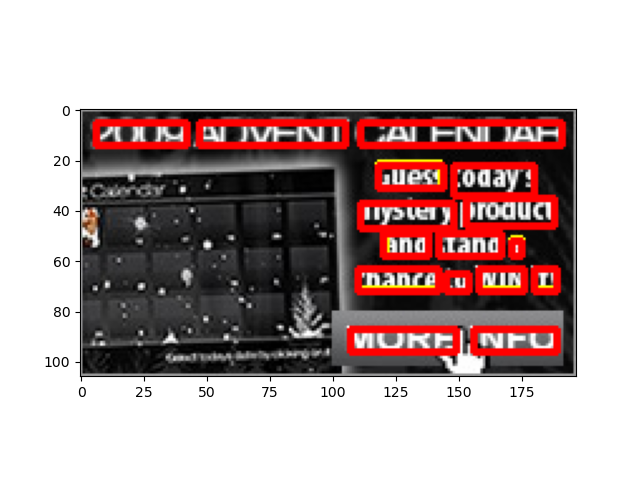

['stayAmsterdam.com', 'Studios', 'from', '€59', 'per', 'night', '(sleeps', '###', '###', '###', '35%', 'discounts', '###', 'stays', '###', 'Jan', 'and', 'Feb', 'Book', 'now', '###']
tensor([[0.6782, 0.1496, 0.5091, 0.1282],
        [0.1191, 0.7778, 0.1000, 0.0513],
        [0.2118, 0.7778, 0.0636, 0.0513],
        [0.2827, 0.7778, 0.0527, 0.0513],
        [0.3445, 0.7927, 0.0455, 0.0556],
        [0.4136, 0.7863, 0.0709, 0.0684],
        [0.4955, 0.7906, 0.0709, 0.0513],
        [0.5500, 0.7885, 0.0164, 0.0470],
        [0.0855, 0.8782, 0.0364, 0.0641],
        [0.1291, 0.8697, 0.0255, 0.0470],
        [0.1809, 0.8675, 0.0564, 0.0513],
        [0.2882, 0.8675, 0.1291, 0.0513],
        [0.3818, 0.8739, 0.0327, 0.0385],
        [0.4455, 0.8782, 0.0691, 0.0641],
        [0.5027, 0.8675, 0.0200, 0.0513],
        [0.5491, 0.8697, 0.0473, 0.0470],
        [0.6109, 0.8675, 0.0509, 0.0513],
        [0.6736, 0.8675, 0.0455, 0.0513],
        [0.7864, 0.8184, 0.0600, 0.0470],
        [0.8545, 0.8

<IPython.core.display.Javascript object>


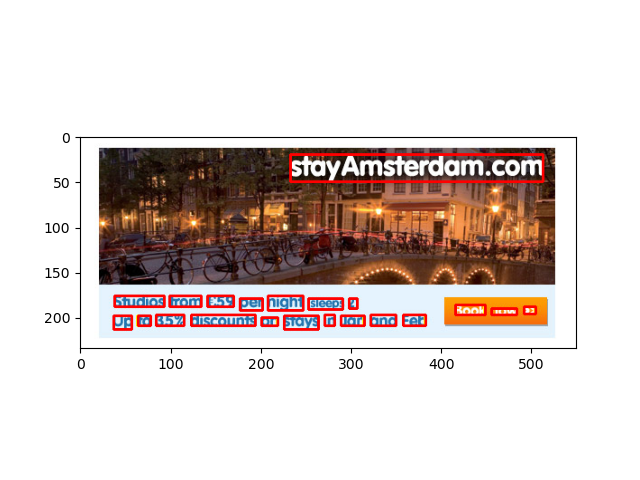

['50%', 'off', 'entire', 'stock', 'furniture', '###', 'mattress', 'sale', 'shop', 'online', '', 'save', '###', '###', 'wide', 'selection', '###', 'rugs']
tensor([[0.1139, 0.0607, 0.1591, 0.0815],
        [0.1718, 0.0851, 0.0434, 0.0290],
        [0.3110, 0.0326, 0.1736, 0.0616],
        [0.5163, 0.0326, 0.1826, 0.0616],
        [0.2875, 0.0888, 0.1302, 0.0290],
        [0.3734, 0.0906, 0.0163, 0.0217],
        [0.4647, 0.0897, 0.1374, 0.0272],
        [0.5759, 0.0888, 0.0633, 0.0290],
        [0.4819, 0.1413, 0.0452, 0.0181],
        [0.5425, 0.1395, 0.0579, 0.0145],
        [0.1456, 0.2065, 0.0452, 0.0217],
        [0.2052, 0.2065, 0.0524, 0.0145],
        [0.2532, 0.2065, 0.0253, 0.0145],
        [0.2803, 0.2065, 0.0108, 0.0145],
        [0.3183, 0.2047, 0.0470, 0.0181],
        [0.3969, 0.2047, 0.0922, 0.0181],
        [0.4611, 0.2047, 0.0181, 0.0181],
        [0.5009, 0.2083, 0.0434, 0.0181]])


<IPython.core.display.Javascript object>


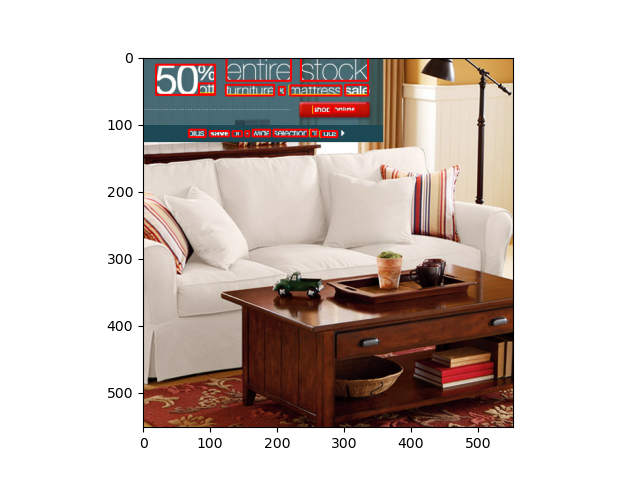

['80%', 'spring', 'discount', 'Cialis', '###', '###', 'Viagra', '###', '###', 'Viagra', 'Super', 'Active', '###', '###', 'Cialis', 'Professional', '###', '###', 'Female', 'Viagra', '###', '###', 'Viagra', 'Professional', '###', '###', 'PayPal', 'VISA']
tensor([[0.1592, 0.1465, 0.1864, 0.1212],
        [0.4126, 0.1881, 0.2583, 0.1439],
        [0.7534, 0.1225, 0.3456, 0.1237],
        [0.1087, 0.4381, 0.0777, 0.0682],
        [0.1854, 0.4217, 0.0485, 0.0657],
        [0.2214, 0.4444, 0.0311, 0.0354],
        [0.3971, 0.3851, 0.0796, 0.0934],
        [0.4786, 0.3384, 0.0447, 0.0606],
        [0.5165, 0.3523, 0.0272, 0.0379],
        [0.6932, 0.5240, 0.0466, 0.1136],
        [0.6932, 0.4078, 0.0583, 0.0934],
        [0.7796, 0.3611, 0.0990, 0.0556],
        [0.8524, 0.4179, 0.0466, 0.0581],
        [0.8748, 0.4634, 0.0214, 0.0328],
        [0.2000, 0.9078, 0.0621, 0.0783],
        [0.2126, 0.7816, 0.1184, 0.1641],
        [0.3029, 0.7285, 0.0505, 0.0682],
        [0.3388, 0.7601, 0.0252, 

<IPython.core.display.Javascript object>


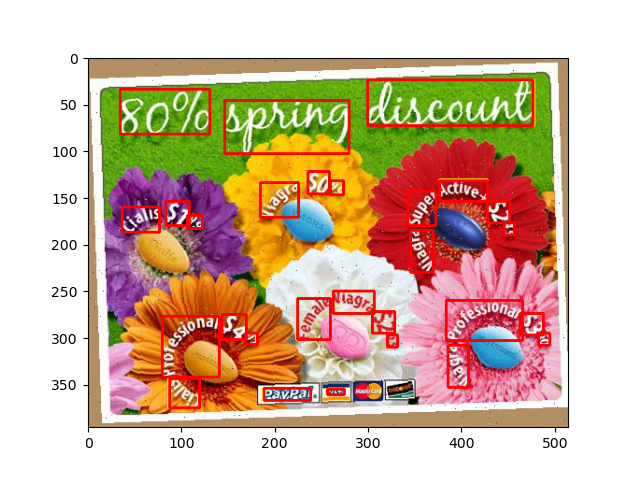

['twitter', 'Twitter']
tensor([[0.2794, 0.5424, 0.3971, 0.0545],
        [0.7096, 0.7182, 0.3897, 0.0909]])


<IPython.core.display.Javascript object>


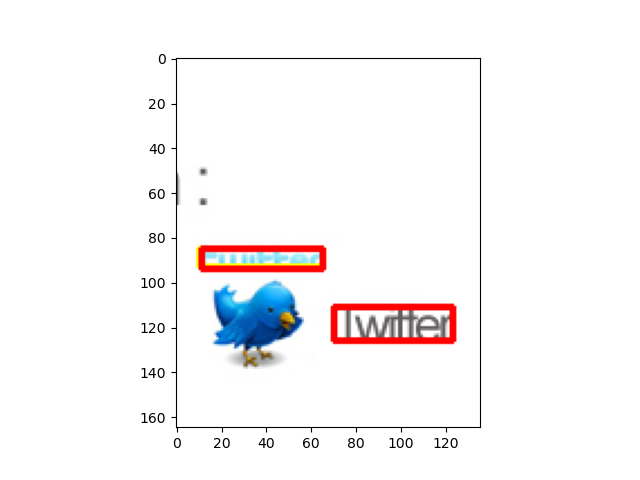

['SPONSORED', 'FREE', 'WEBINAR', 'Advanced', 'Agile:', 'Beyond', 'the', 'Low', 'Hanging', 'Fruit', 'Date:', '', 'February', '###', '2:00', '###', '###', '###', 'Mary', 'Poppendieck', 'MKS', '###', '###', 'COMPUTER.ORG/WEBINARS/AGILE2']
tensor([[0.1800, 0.0700, 0.2720, 0.0440],
        [0.1880, 0.1760, 0.2720, 0.1040],
        [0.6520, 0.1760, 0.5520, 0.1040],
        [0.6880, 0.4460, 0.2000, 0.0360],
        [0.8620, 0.4500, 0.1160, 0.0440],
        [0.3800, 0.5000, 0.1520, 0.0480],
        [0.5040, 0.4940, 0.0640, 0.0360],
        [0.5920, 0.4940, 0.0800, 0.0360],
        [0.7340, 0.5000, 0.1720, 0.0480],
        [0.8820, 0.4940, 0.0920, 0.0360],
        [0.3780, 0.5440, 0.1000, 0.0320],
        [0.5720, 0.5480, 0.2480, 0.0480],
        [0.8020, 0.5460, 0.1800, 0.0440],
        [0.9200, 0.5440, 0.0160, 0.0320],
        [0.7500, 0.5920, 0.0840, 0.0320],
        [0.8380, 0.5900, 0.0600, 0.0360],
        [0.9060, 0.5920, 0.0440, 0.0320],
        [0.4980, 0.6440, 0.0440, 0.0480],
        

<IPython.core.display.Javascript object>


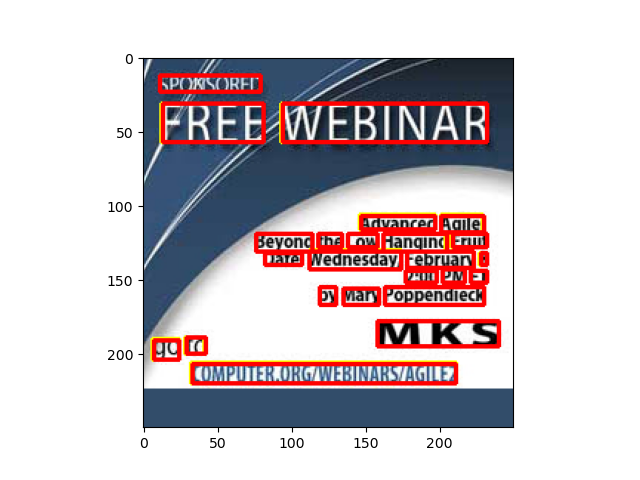

['Must', 'Go!', 'Chicco', 'Musical', 'Bunny', 'Rabbit', 'Stroller', 'Toy', 'Was', '£11.97', 'NOW', '£5.99', '50%', 'Off']
tensor([[0.6795, 0.1233, 0.1227, 0.0933],
        [0.7977, 0.2067, 0.0955, 0.0733],
        [0.2068, 0.6883, 0.1773, 0.0300],
        [0.4205, 0.6883, 0.2045, 0.0300],
        [0.6341, 0.6933, 0.1591, 0.0400],
        [0.2068, 0.7450, 0.1773, 0.0300],
        [0.4159, 0.7450, 0.1955, 0.0300],
        [0.5977, 0.7500, 0.0955, 0.0400],
        [0.1659, 0.8383, 0.1045, 0.0300],
        [0.3409, 0.8383, 0.1818, 0.0300],
        [0.2023, 0.9033, 0.1682, 0.0400],
        [0.4136, 0.9033, 0.1818, 0.0400],
        [0.7182, 0.8517, 0.0727, 0.0233],
        [0.8091, 0.8517, 0.0636, 0.0233]])


<IPython.core.display.Javascript object>


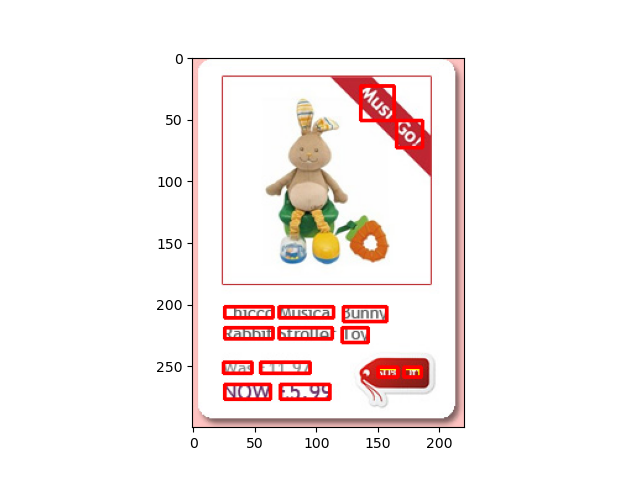

['Save', '###', '###', '50%']
tensor([[0.2200, 0.4664, 0.2364, 0.3657],
        [0.4382, 0.5485, 0.1164, 0.3657],
        [0.5827, 0.4701, 0.0964, 0.3582],
        [0.7791, 0.4701, 0.2164, 0.3582]])


<IPython.core.display.Javascript object>


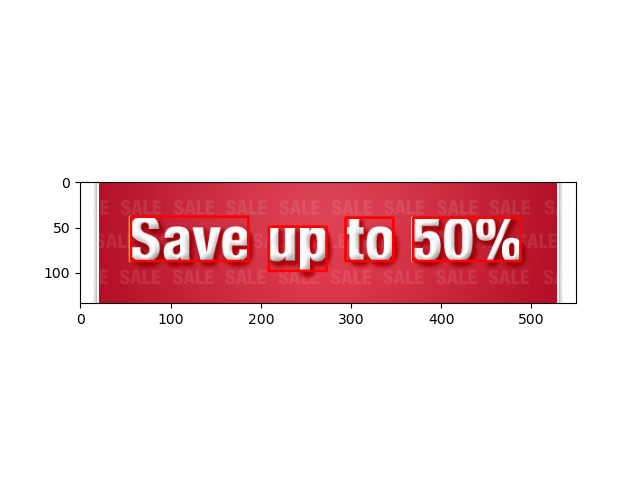

In [12]:
indices = np.random.randint(0, len(train_dataset), 15)

for index in indices:
    img, targets, texts = train_dataset[index]
    
    locs, quads = targets[:, :4], targets[:, 4:12]
    
    print(texts)
    print(locs)
    img = toVisualizeRectRGBimg(img, locs, rgb=(255,255,0), verbose=False)# yellow
    img = toVisualizeQuadsRGBimg(torch.from_numpy(img.transpose((2, 0, 1)) / 255.), quads, verbose=False)# red

    plt.figure()
    plt.imshow(img)